<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_10_layers_earlyStop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

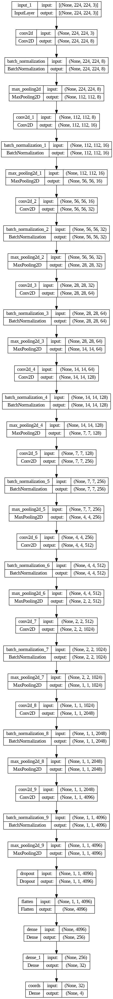

In [18]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True)

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    keras.callbacks.EarlyStopping(
    monitor = 'val_IoU',
    patience = 20,
    verbose=1,
    mode = 'max',
    restore_best_weights=True,
    start_from_epoch = 100
    ),
    ShowTestImages()
]

In [23]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [24]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 42.0751 - IoU: 0.0396
Epoch 1: val_IoU improved from -inf to 0.00000, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 96ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 39ms/step
4


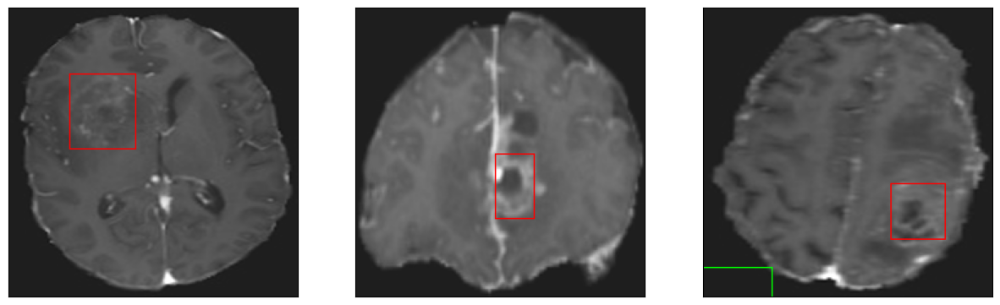

26/26 [==============================] - 41s 808ms/step - loss: 42.0751 - IoU: 0.0396 - val_loss: 564.8749 - val_IoU: 0.0000e+00
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 27.6212 - IoU: 0.0569
Epoch 2: val_IoU improved from 0.00000 to 0.00140, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4


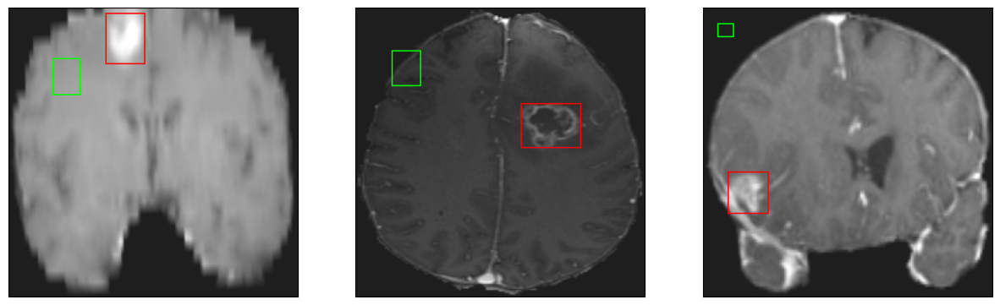

26/26 [==============================] - 14s 542ms/step - loss: 27.6212 - IoU: 0.0569 - val_loss: 55.9269 - val_IoU: 0.0014
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 26.0776 - IoU: 0.0787
Epoch 3: val_IoU did not improve from 0.00140
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


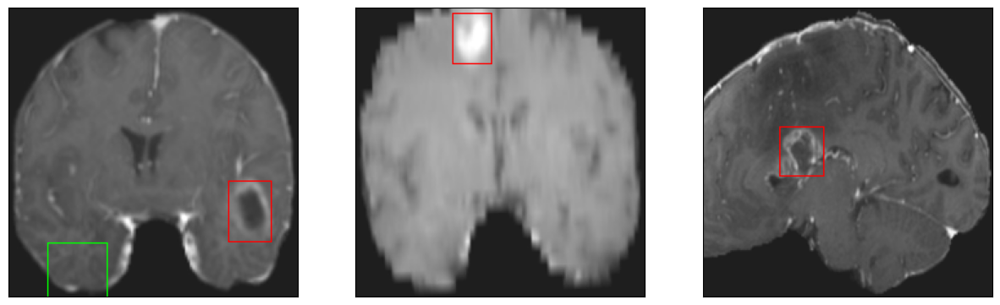

26/26 [==============================] - 7s 274ms/step - loss: 26.0776 - IoU: 0.0787 - val_loss: 70.0388 - val_IoU: 0.0000e+00
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 24.4098 - IoU: 0.1000
Epoch 4: val_IoU did not improve from 0.00140
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 39ms/step
4
8/8 [==============================] - 0s 40ms/step
4


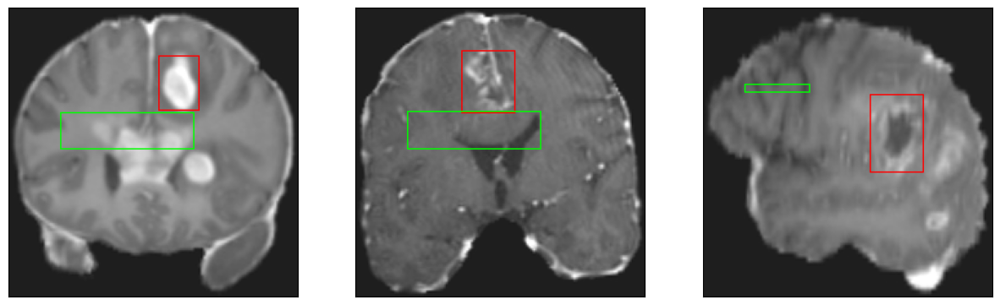

26/26 [==============================] - 8s 301ms/step - loss: 24.4098 - IoU: 0.1000 - val_loss: 46.5002 - val_IoU: 0.0000e+00
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 24.5611 - IoU: 0.1000
Epoch 5: val_IoU did not improve from 0.00140
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


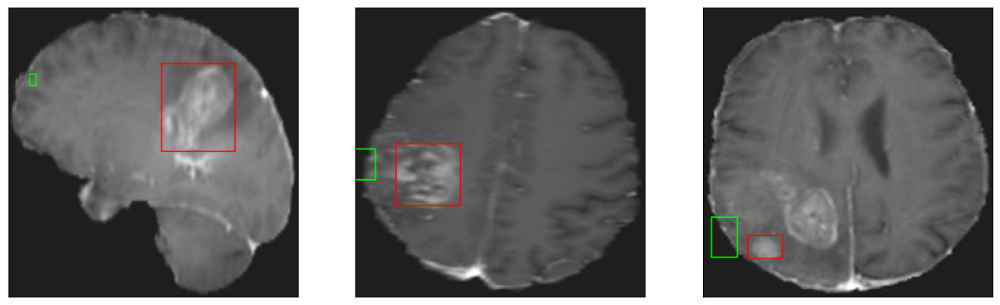

26/26 [==============================] - 8s 302ms/step - loss: 24.5611 - IoU: 0.1000 - val_loss: 52.5926 - val_IoU: 0.0000e+00
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 20.9433 - IoU: 0.1496
Epoch 6: val_IoU improved from 0.00140 to 0.00197, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


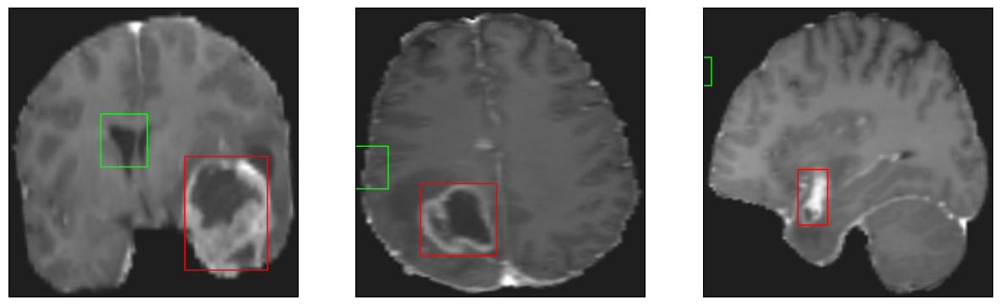

26/26 [==============================] - 24s 934ms/step - loss: 20.9433 - IoU: 0.1496 - val_loss: 50.2451 - val_IoU: 0.0020
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 18.3804 - IoU: 0.1831
Epoch 7: val_IoU improved from 0.00197 to 0.05821, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


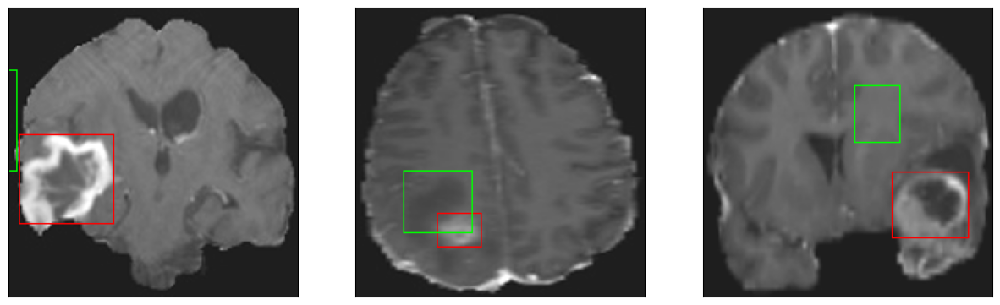

26/26 [==============================] - 24s 943ms/step - loss: 18.3804 - IoU: 0.1831 - val_loss: 31.4060 - val_IoU: 0.0582
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 18.0993 - IoU: 0.2162
Epoch 8: val_IoU did not improve from 0.05821
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


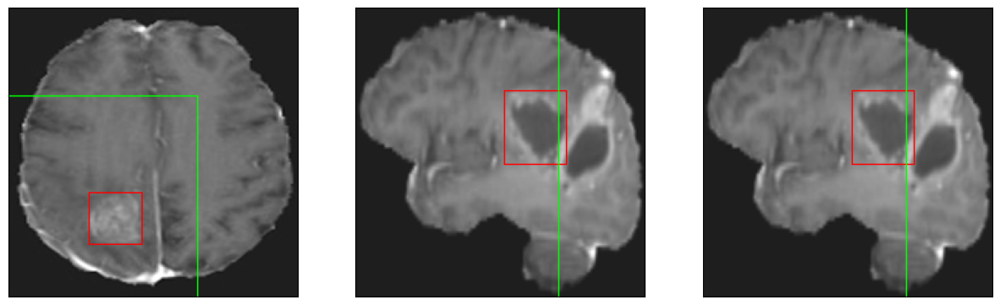

26/26 [==============================] - 8s 297ms/step - loss: 18.0993 - IoU: 0.2162 - val_loss: 122.4868 - val_IoU: 0.0498
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 17.1293 - IoU: 0.2284
Epoch 9: val_IoU improved from 0.05821 to 0.13480, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


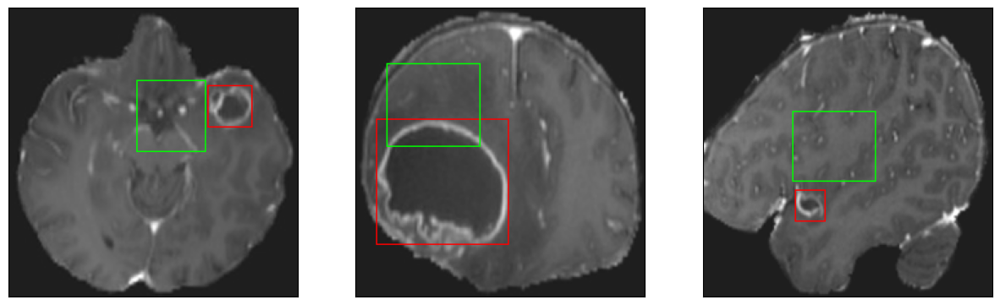

26/26 [==============================] - 25s 993ms/step - loss: 17.1293 - IoU: 0.2284 - val_loss: 52.9764 - val_IoU: 0.1348
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 16.7490 - IoU: 0.2345
Epoch 10: val_IoU did not improve from 0.13480
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


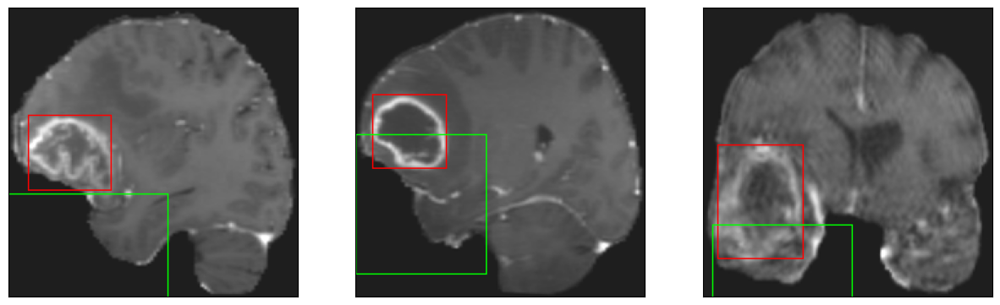

26/26 [==============================] - 7s 273ms/step - loss: 16.7490 - IoU: 0.2345 - val_loss: 58.2741 - val_IoU: 0.0912
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 15.8348 - IoU: 0.2561
Epoch 11: val_IoU improved from 0.13480 to 0.17949, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 40ms/step
4


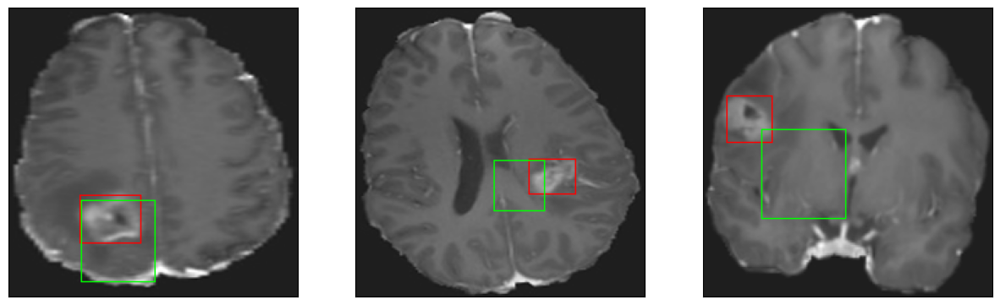

26/26 [==============================] - 19s 737ms/step - loss: 15.8348 - IoU: 0.2561 - val_loss: 39.1490 - val_IoU: 0.1795
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 14.8352 - IoU: 0.2895
Epoch 12: val_IoU improved from 0.17949 to 0.26491, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4


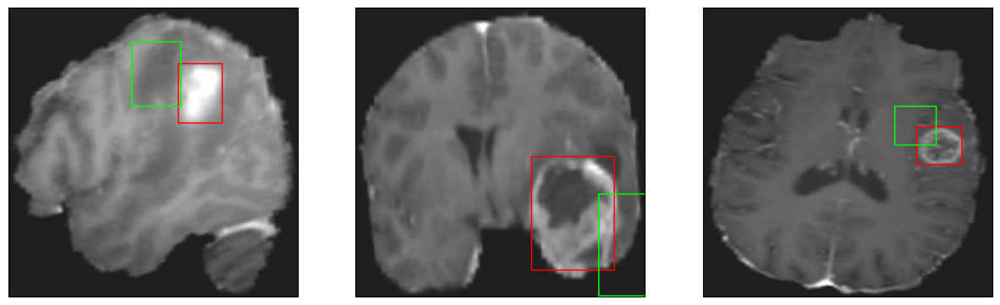

26/26 [==============================] - 15s 583ms/step - loss: 14.8352 - IoU: 0.2895 - val_loss: 16.1958 - val_IoU: 0.2649
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 14.3502 - IoU: 0.2930
Epoch 13: val_IoU improved from 0.26491 to 0.27161, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


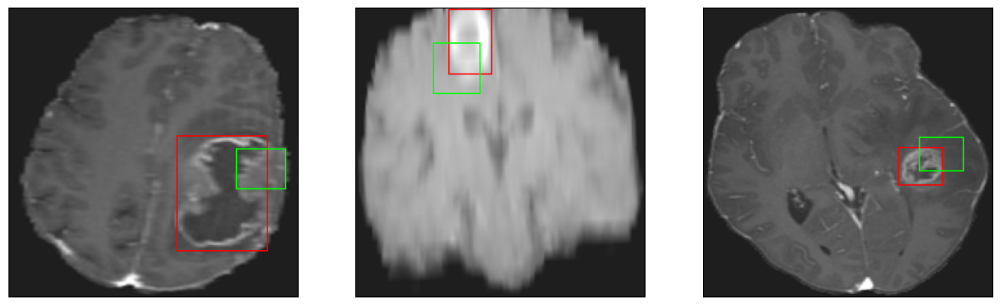

26/26 [==============================] - 13s 512ms/step - loss: 14.3502 - IoU: 0.2930 - val_loss: 17.1780 - val_IoU: 0.2716
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 13.5708 - IoU: 0.3120
Epoch 14: val_IoU did not improve from 0.27161
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


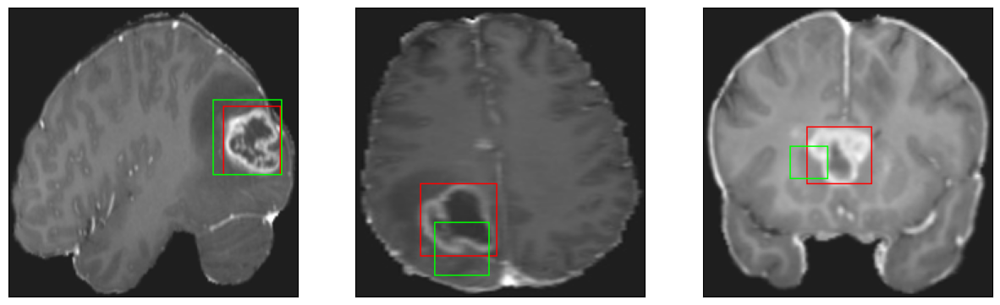

26/26 [==============================] - 7s 287ms/step - loss: 13.5708 - IoU: 0.3120 - val_loss: 15.2047 - val_IoU: 0.2568
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 12.6030 - IoU: 0.3266
Epoch 15: val_IoU improved from 0.27161 to 0.27489, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


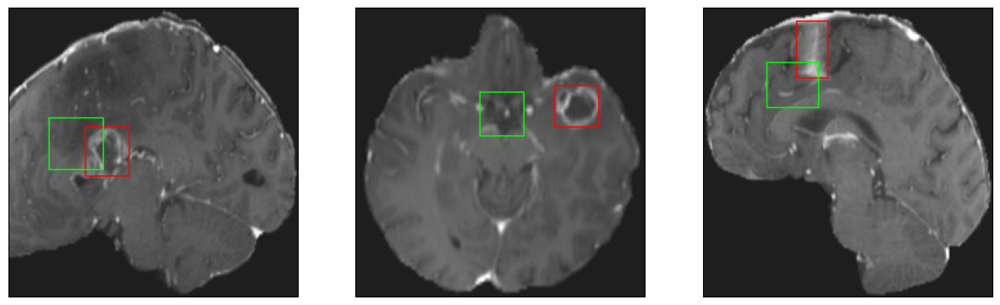

26/26 [==============================] - 30s 1s/step - loss: 12.6030 - IoU: 0.3266 - val_loss: 15.3472 - val_IoU: 0.2749
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 13.1035 - IoU: 0.3063
Epoch 16: val_IoU improved from 0.27489 to 0.27511, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


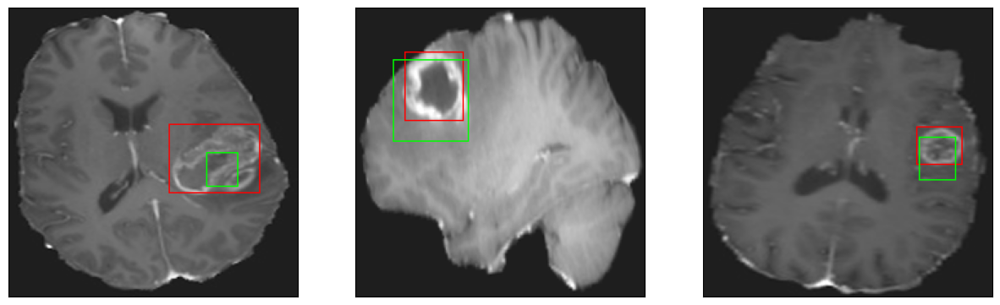

26/26 [==============================] - 24s 936ms/step - loss: 13.1035 - IoU: 0.3063 - val_loss: 14.5369 - val_IoU: 0.2751
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 12.1788 - IoU: 0.3442
Epoch 17: val_IoU did not improve from 0.27511
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


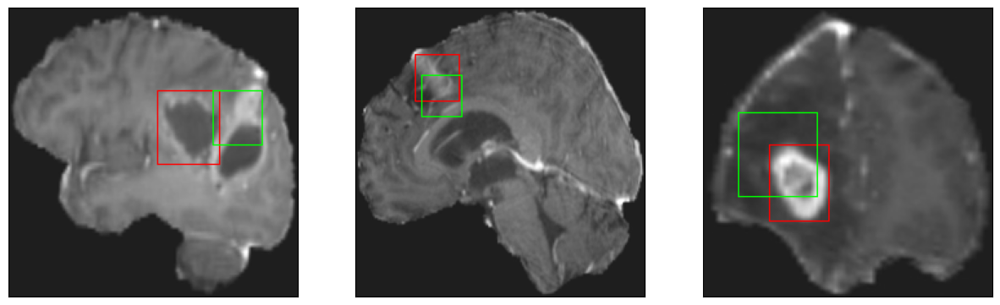

26/26 [==============================] - 8s 305ms/step - loss: 12.1788 - IoU: 0.3442 - val_loss: 16.1097 - val_IoU: 0.2538
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 11.9740 - IoU: 0.3478
Epoch 18: val_IoU improved from 0.27511 to 0.29402, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


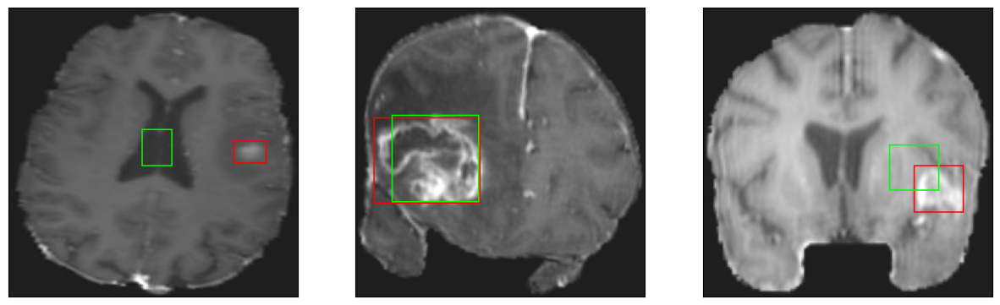

26/26 [==============================] - 25s 975ms/step - loss: 11.9740 - IoU: 0.3478 - val_loss: 14.7728 - val_IoU: 0.2940
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 11.9730 - IoU: 0.3409
Epoch 19: val_IoU improved from 0.29402 to 0.37356, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4


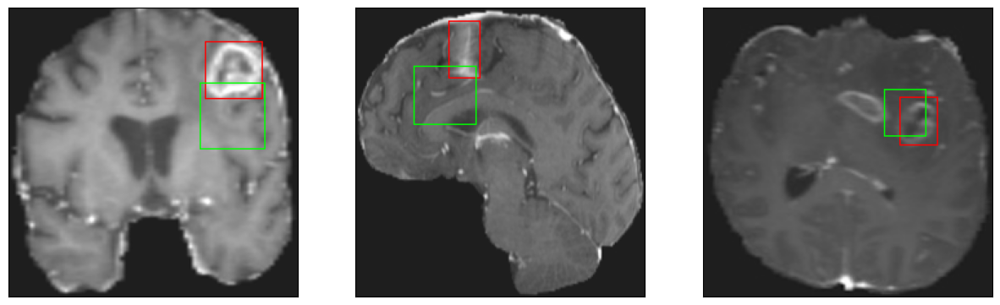

26/26 [==============================] - 25s 1s/step - loss: 11.9730 - IoU: 0.3409 - val_loss: 13.1053 - val_IoU: 0.3736
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 11.7253 - IoU: 0.3530
Epoch 20: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


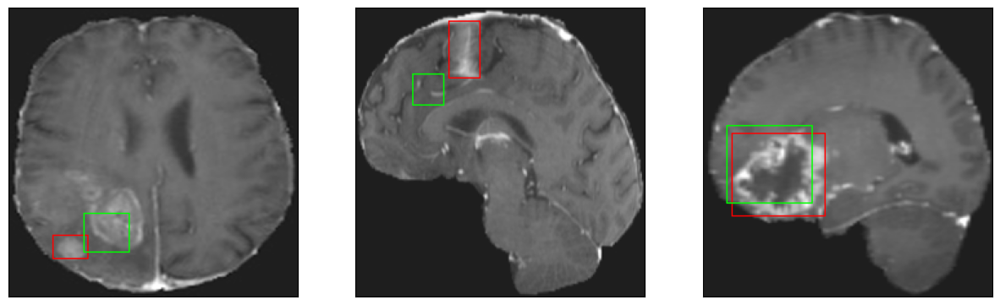

26/26 [==============================] - 8s 301ms/step - loss: 11.7253 - IoU: 0.3530 - val_loss: 14.3157 - val_IoU: 0.2856
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 11.7843 - IoU: 0.3529
Epoch 21: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


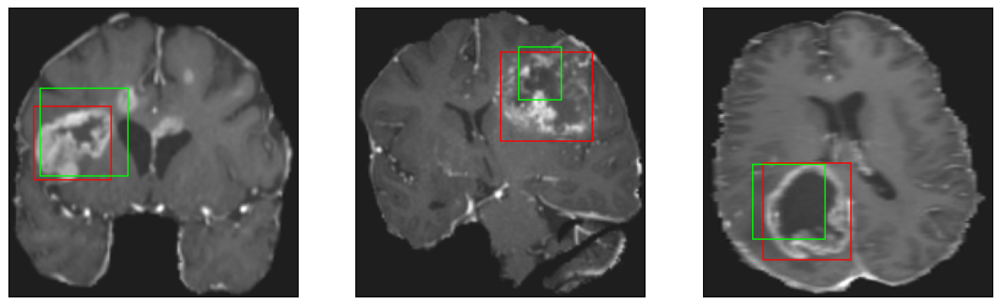

26/26 [==============================] - 8s 301ms/step - loss: 11.7843 - IoU: 0.3529 - val_loss: 12.8565 - val_IoU: 0.3575
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 11.6418 - IoU: 0.3501
Epoch 22: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


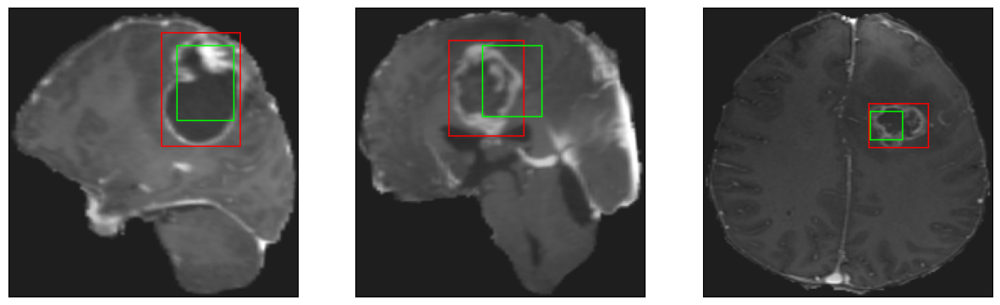

26/26 [==============================] - 7s 287ms/step - loss: 11.6418 - IoU: 0.3501 - val_loss: 12.3790 - val_IoU: 0.3690
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 11.0795 - IoU: 0.3651
Epoch 23: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


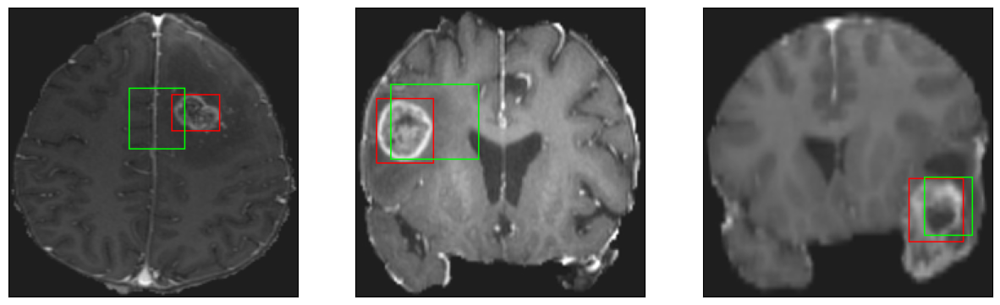

26/26 [==============================] - 8s 299ms/step - loss: 11.0795 - IoU: 0.3651 - val_loss: 14.3718 - val_IoU: 0.3226
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 11.3492 - IoU: 0.3601
Epoch 24: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4


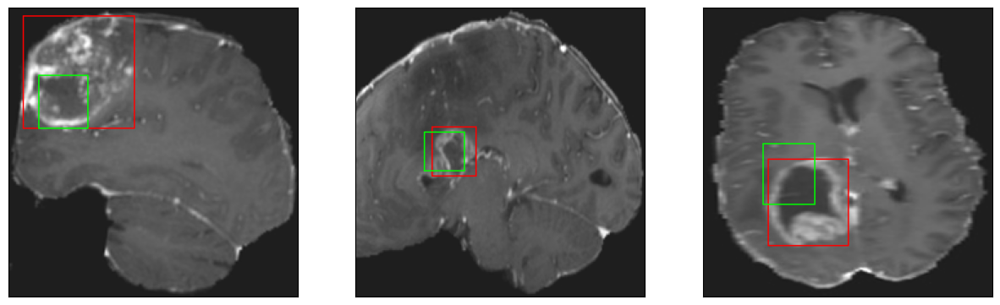

26/26 [==============================] - 8s 298ms/step - loss: 11.3492 - IoU: 0.3601 - val_loss: 14.6773 - val_IoU: 0.3007
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 10.7805 - IoU: 0.3744
Epoch 25: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


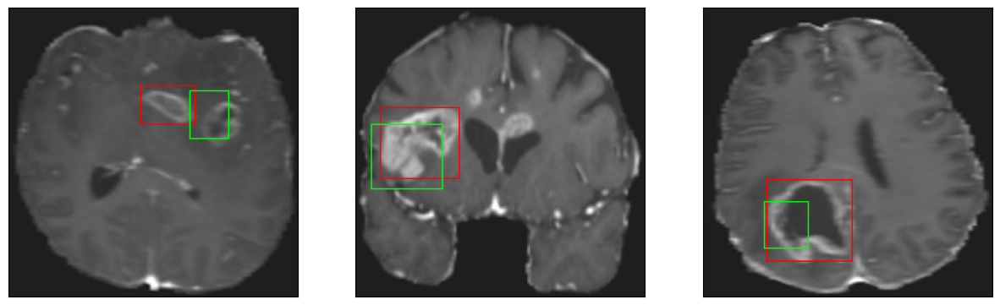

26/26 [==============================] - 7s 265ms/step - loss: 10.7805 - IoU: 0.3744 - val_loss: 14.3679 - val_IoU: 0.3021
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 10.3918 - IoU: 0.3845
Epoch 26: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


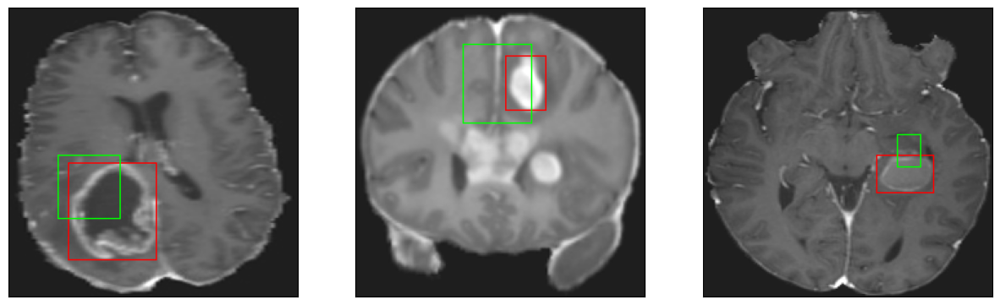

26/26 [==============================] - 8s 300ms/step - loss: 10.3918 - IoU: 0.3845 - val_loss: 12.0272 - val_IoU: 0.3662
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 9.8851 - IoU: 0.4109
Epoch 27: val_IoU did not improve from 0.37356
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


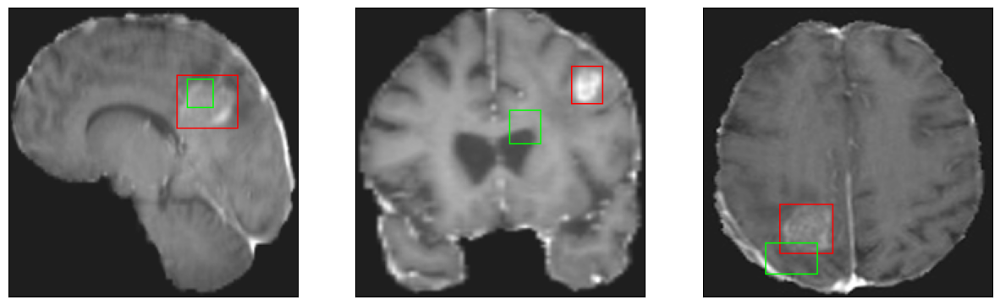

26/26 [==============================] - 8s 304ms/step - loss: 9.8851 - IoU: 0.4109 - val_loss: 12.6952 - val_IoU: 0.3519
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 9.9233 - IoU: 0.4059
Epoch 28: val_IoU improved from 0.37356 to 0.41388, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


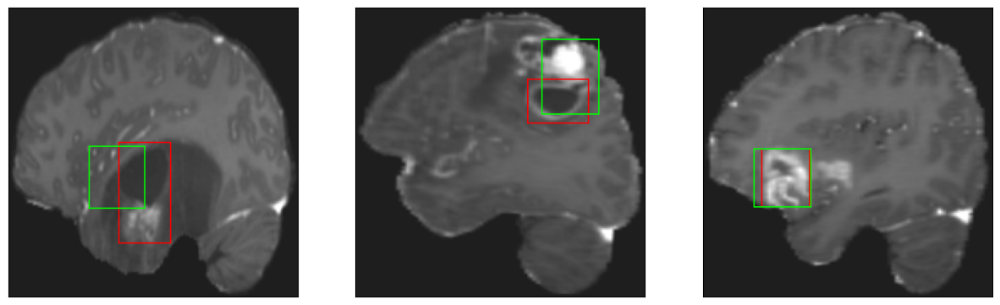

26/26 [==============================] - 23s 910ms/step - loss: 9.9233 - IoU: 0.4059 - val_loss: 11.7231 - val_IoU: 0.4139
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 9.5661 - IoU: 0.4117
Epoch 29: val_IoU improved from 0.41388 to 0.41422, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 40ms/step
4


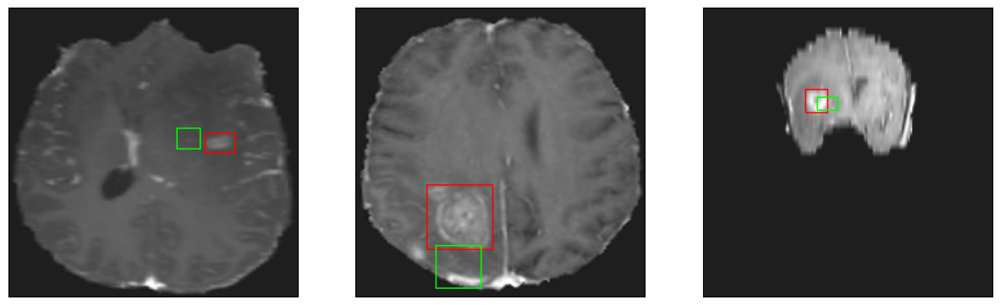

26/26 [==============================] - 30s 1s/step - loss: 9.5661 - IoU: 0.4117 - val_loss: 11.5805 - val_IoU: 0.4142
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 9.4494 - IoU: 0.4183
Epoch 30: val_IoU did not improve from 0.41422
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


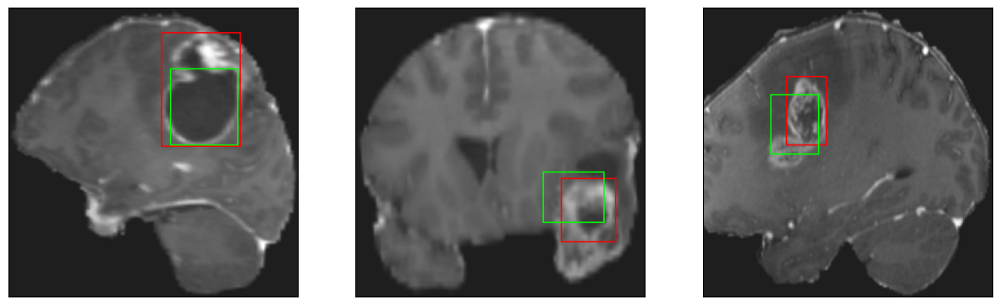

26/26 [==============================] - 8s 290ms/step - loss: 9.4494 - IoU: 0.4183 - val_loss: 11.5753 - val_IoU: 0.3888
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 9.7486 - IoU: 0.4173
Epoch 31: val_IoU did not improve from 0.41422
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


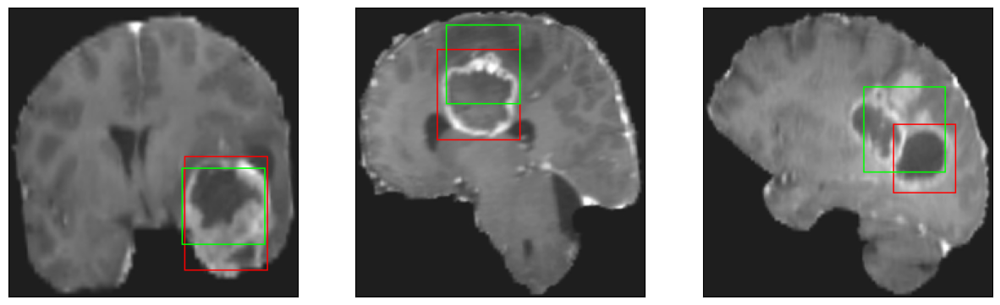

26/26 [==============================] - 7s 279ms/step - loss: 9.7486 - IoU: 0.4173 - val_loss: 11.8410 - val_IoU: 0.3958
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 9.5754 - IoU: 0.4041
Epoch 32: val_IoU improved from 0.41422 to 0.42903, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


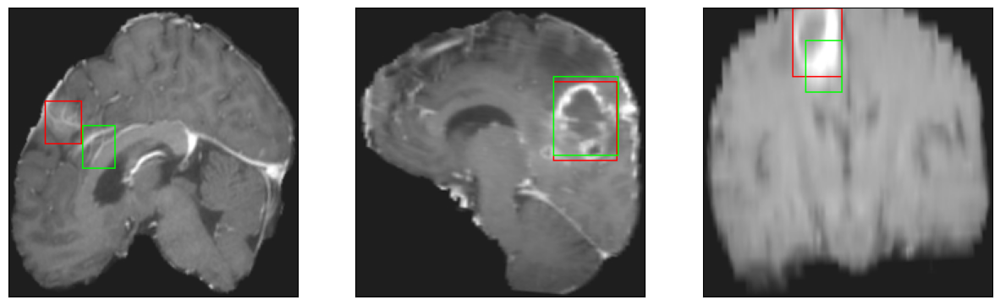

26/26 [==============================] - 24s 966ms/step - loss: 9.5754 - IoU: 0.4041 - val_loss: 11.1922 - val_IoU: 0.4290
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 9.1601 - IoU: 0.4244
Epoch 33: val_IoU did not improve from 0.42903
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


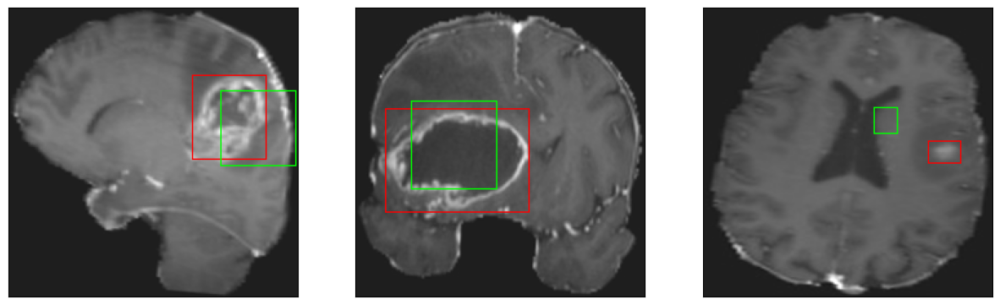

26/26 [==============================] - 8s 298ms/step - loss: 9.1601 - IoU: 0.4244 - val_loss: 11.8690 - val_IoU: 0.3563
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 9.5127 - IoU: 0.4167
Epoch 34: val_IoU improved from 0.42903 to 0.43913, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


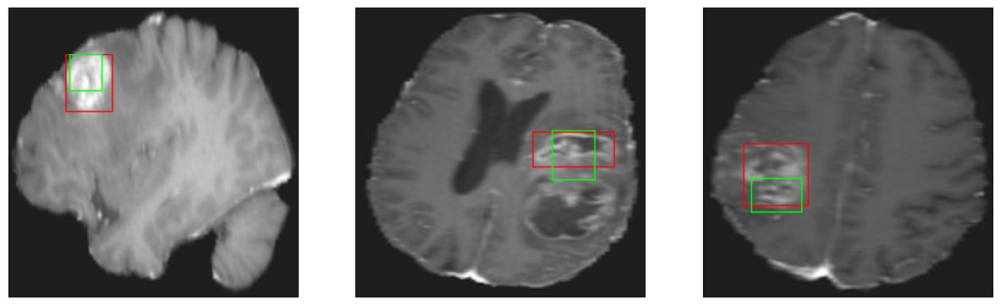

26/26 [==============================] - 22s 872ms/step - loss: 9.5127 - IoU: 0.4167 - val_loss: 10.5514 - val_IoU: 0.4391
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 9.3678 - IoU: 0.4249
Epoch 35: val_IoU did not improve from 0.43913
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


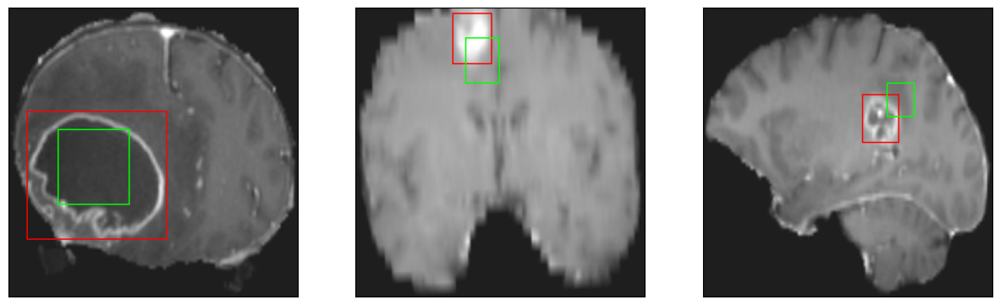

26/26 [==============================] - 7s 290ms/step - loss: 9.3678 - IoU: 0.4249 - val_loss: 11.8236 - val_IoU: 0.3718
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 9.0020 - IoU: 0.4346
Epoch 36: val_IoU did not improve from 0.43913
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


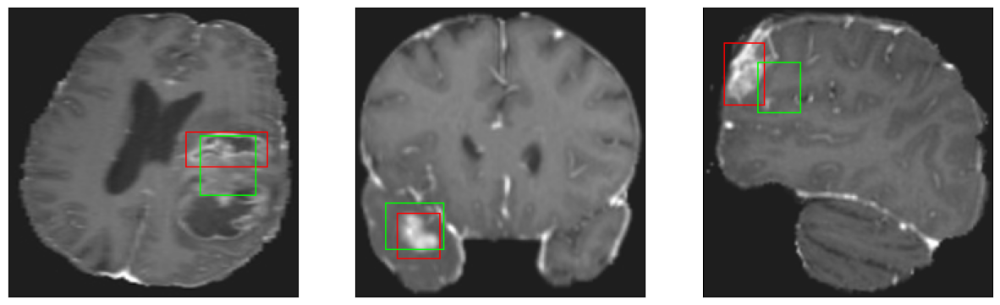

26/26 [==============================] - 8s 319ms/step - loss: 9.0020 - IoU: 0.4346 - val_loss: 11.2753 - val_IoU: 0.4128
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 9.0617 - IoU: 0.4355
Epoch 37: val_IoU did not improve from 0.43913
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


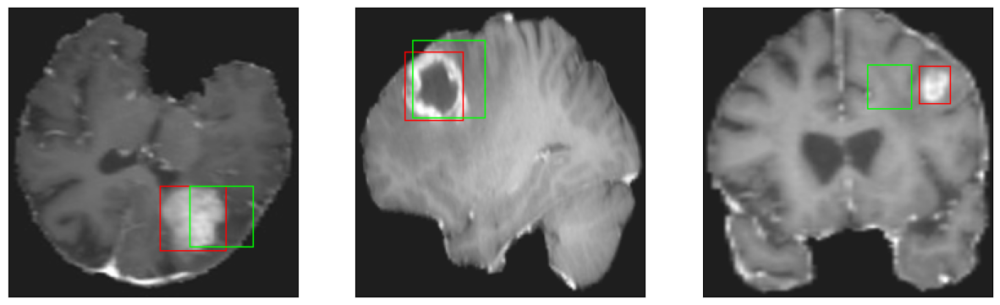

26/26 [==============================] - 7s 290ms/step - loss: 9.0617 - IoU: 0.4355 - val_loss: 10.8356 - val_IoU: 0.4175
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 9.1038 - IoU: 0.4253
Epoch 38: val_IoU improved from 0.43913 to 0.44769, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


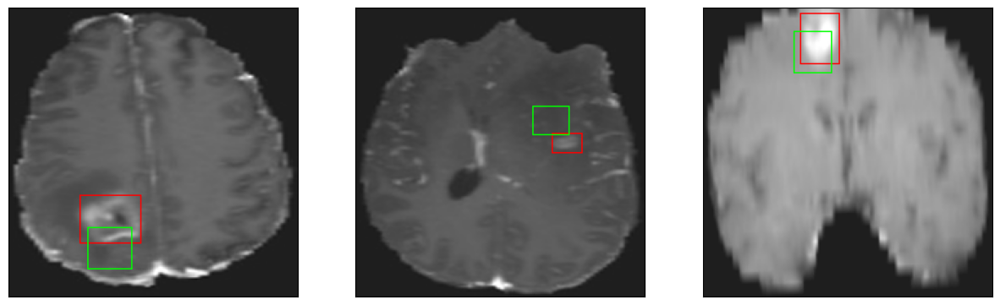

26/26 [==============================] - 28s 1s/step - loss: 9.1038 - IoU: 0.4253 - val_loss: 11.0825 - val_IoU: 0.4477
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 8.8397 - IoU: 0.4396
Epoch 39: val_IoU did not improve from 0.44769
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


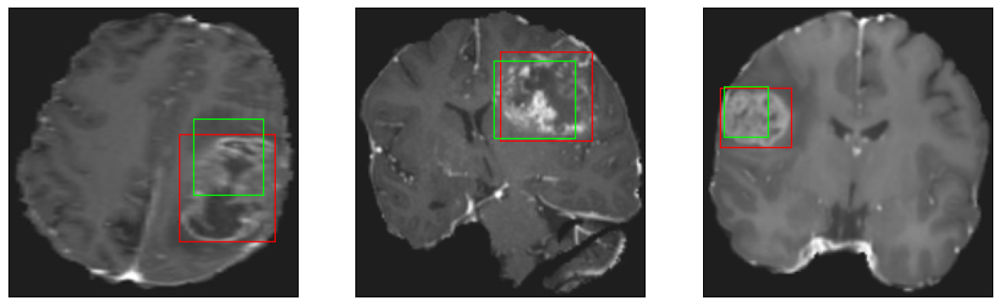

26/26 [==============================] - 8s 306ms/step - loss: 8.8397 - IoU: 0.4396 - val_loss: 11.4183 - val_IoU: 0.4162
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 8.6147 - IoU: 0.4565
Epoch 40: val_IoU did not improve from 0.44769
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 46ms/step
4


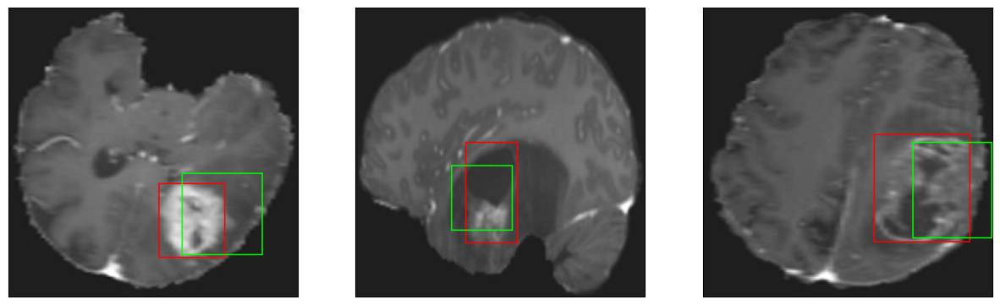

26/26 [==============================] - 7s 283ms/step - loss: 8.6147 - IoU: 0.4565 - val_loss: 12.2305 - val_IoU: 0.4244
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 8.3153 - IoU: 0.4733
Epoch 41: val_IoU did not improve from 0.44769
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


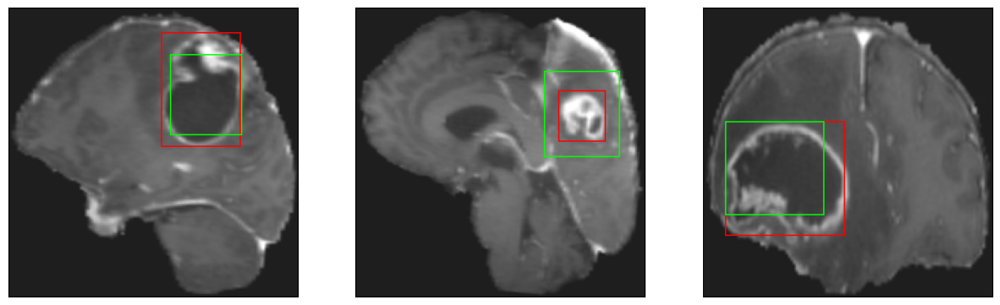

26/26 [==============================] - 7s 285ms/step - loss: 8.3153 - IoU: 0.4733 - val_loss: 12.0567 - val_IoU: 0.4028
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 8.4108 - IoU: 0.4585
Epoch 42: val_IoU improved from 0.44769 to 0.46590, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


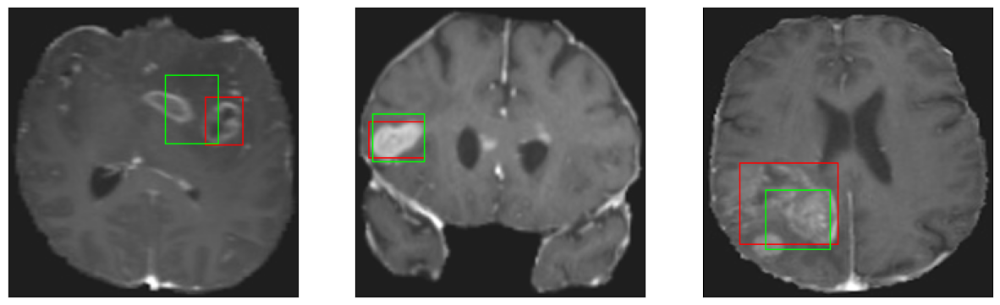

26/26 [==============================] - 26s 1s/step - loss: 8.4108 - IoU: 0.4585 - val_loss: 10.4031 - val_IoU: 0.4659
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 8.2663 - IoU: 0.4706
Epoch 43: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


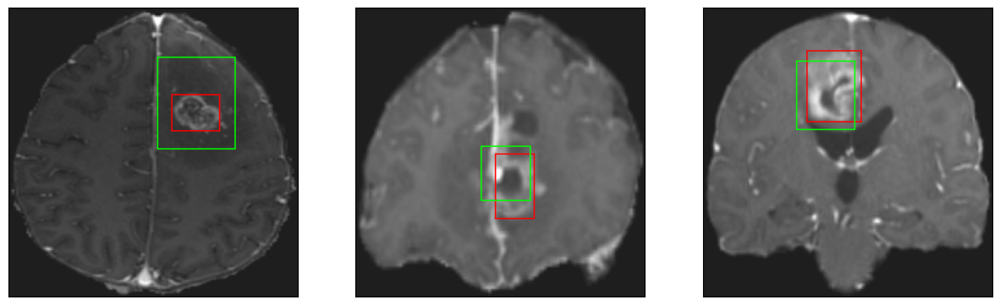

26/26 [==============================] - 7s 286ms/step - loss: 8.2663 - IoU: 0.4706 - val_loss: 10.1310 - val_IoU: 0.4616
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.2312 - IoU: 0.4650
Epoch 44: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 46ms/step
4


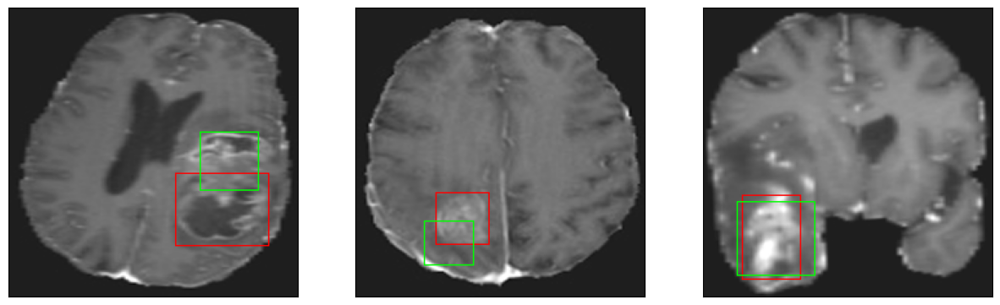

26/26 [==============================] - 8s 297ms/step - loss: 8.2312 - IoU: 0.4650 - val_loss: 11.1749 - val_IoU: 0.3987
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.4513 - IoU: 0.4624
Epoch 45: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


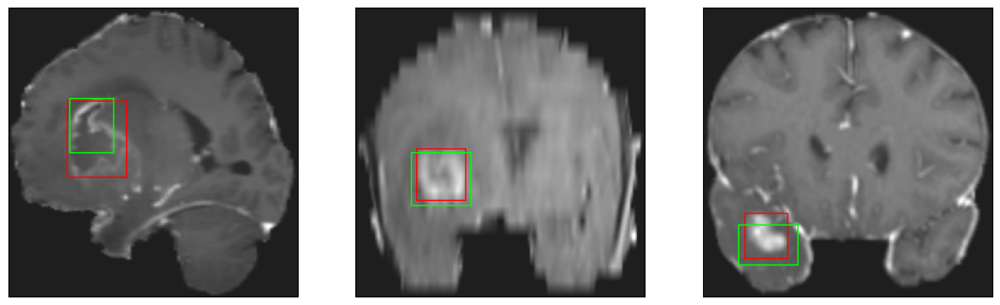

26/26 [==============================] - 7s 281ms/step - loss: 8.4513 - IoU: 0.4624 - val_loss: 10.4725 - val_IoU: 0.4502
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.4076 - IoU: 0.4605
Epoch 46: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


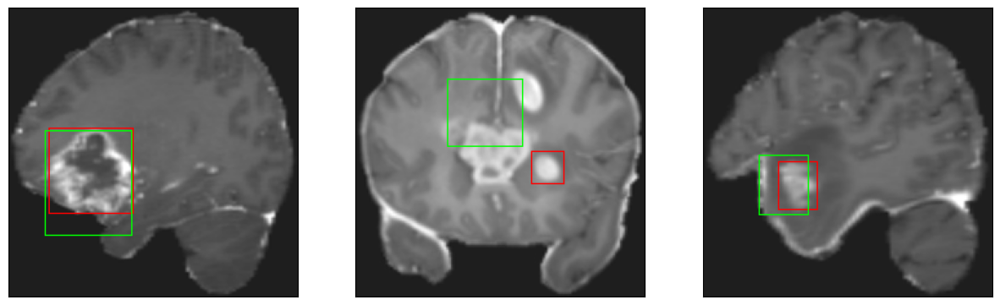

26/26 [==============================] - 7s 279ms/step - loss: 8.4076 - IoU: 0.4605 - val_loss: 10.9299 - val_IoU: 0.4377
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 8.5978 - IoU: 0.4608
Epoch 47: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


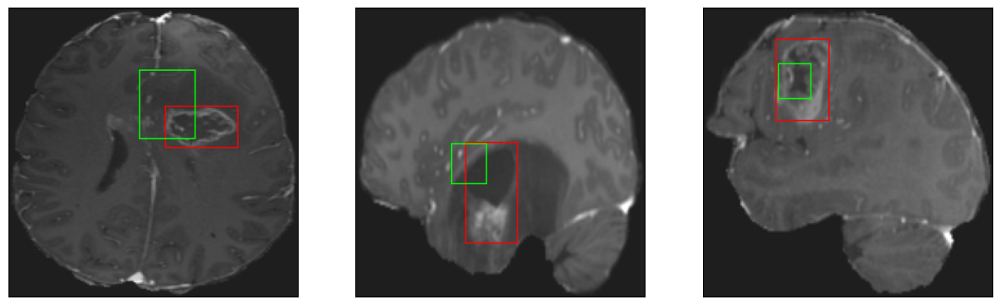

26/26 [==============================] - 8s 310ms/step - loss: 8.5978 - IoU: 0.4608 - val_loss: 11.2475 - val_IoU: 0.3920
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 8.7074 - IoU: 0.4532
Epoch 48: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


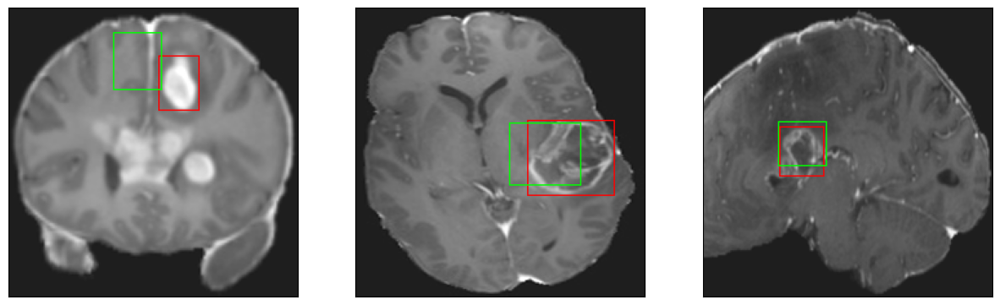

26/26 [==============================] - 7s 278ms/step - loss: 8.7074 - IoU: 0.4532 - val_loss: 11.4973 - val_IoU: 0.3802
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 8.4827 - IoU: 0.4571
Epoch 49: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


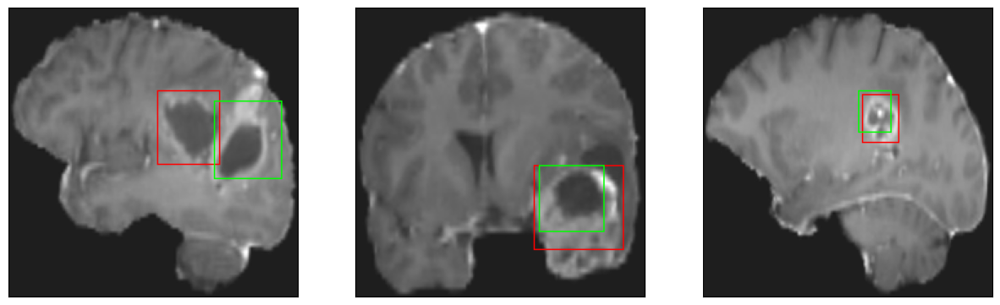

26/26 [==============================] - 8s 292ms/step - loss: 8.4827 - IoU: 0.4571 - val_loss: 10.1981 - val_IoU: 0.4621
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.3706 - IoU: 0.4602
Epoch 50: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


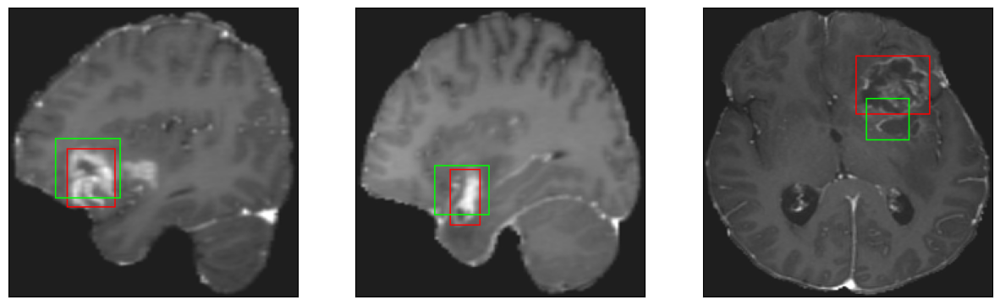

26/26 [==============================] - 8s 295ms/step - loss: 8.3706 - IoU: 0.4602 - val_loss: 10.1354 - val_IoU: 0.4621
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 8.4745 - IoU: 0.4570
Epoch 51: val_IoU did not improve from 0.46590
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


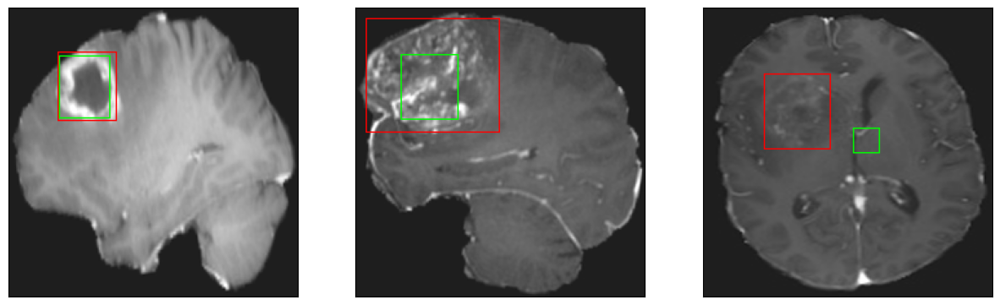

26/26 [==============================] - 7s 282ms/step - loss: 8.4745 - IoU: 0.4570 - val_loss: 11.2567 - val_IoU: 0.3903
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 7.9929 - IoU: 0.4685
Epoch 52: val_IoU improved from 0.46590 to 0.46897, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 49ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


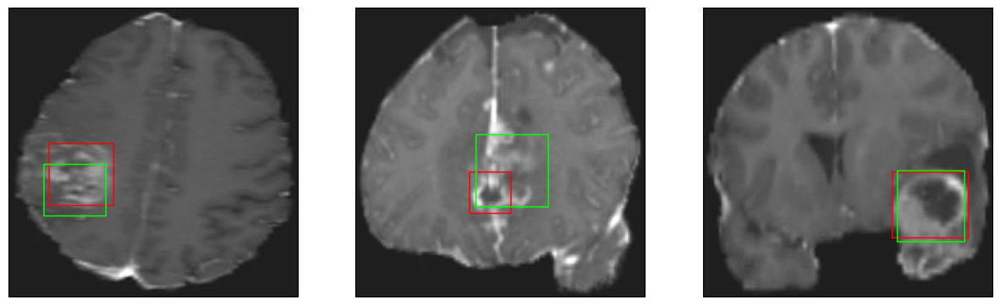

26/26 [==============================] - 34s 1s/step - loss: 7.9929 - IoU: 0.4685 - val_loss: 10.0489 - val_IoU: 0.4690
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 7.7760 - IoU: 0.4895
Epoch 53: val_IoU improved from 0.46897 to 0.48056, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 46ms/step
4


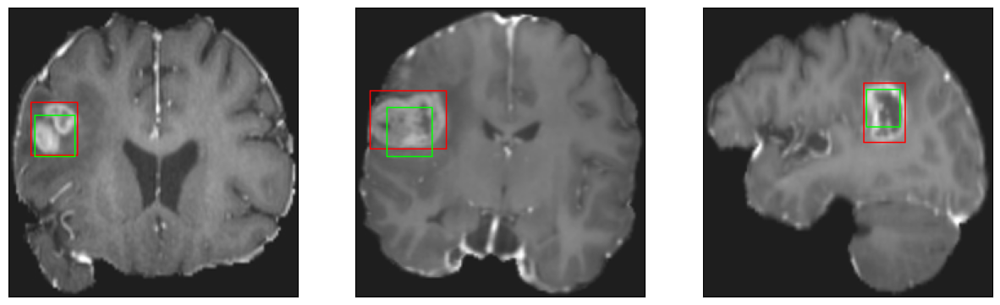

26/26 [==============================] - 28s 1s/step - loss: 7.7760 - IoU: 0.4895 - val_loss: 10.1256 - val_IoU: 0.4806
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 7.7709 - IoU: 0.4897
Epoch 54: val_IoU improved from 0.48056 to 0.48389, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


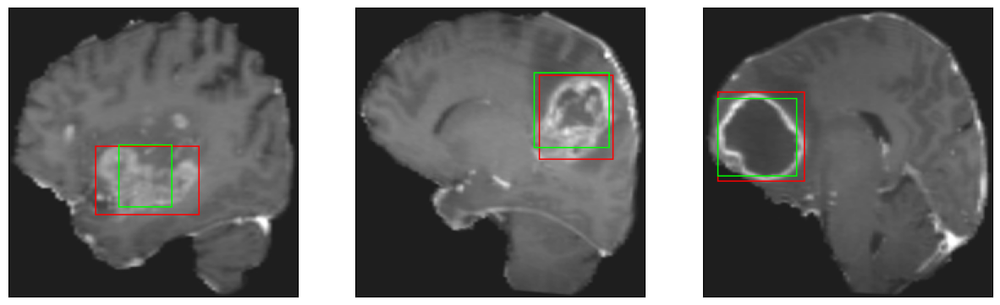

26/26 [==============================] - 23s 905ms/step - loss: 7.7709 - IoU: 0.4897 - val_loss: 9.6509 - val_IoU: 0.4839
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 8.0801 - IoU: 0.4686
Epoch 55: val_IoU did not improve from 0.48389
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


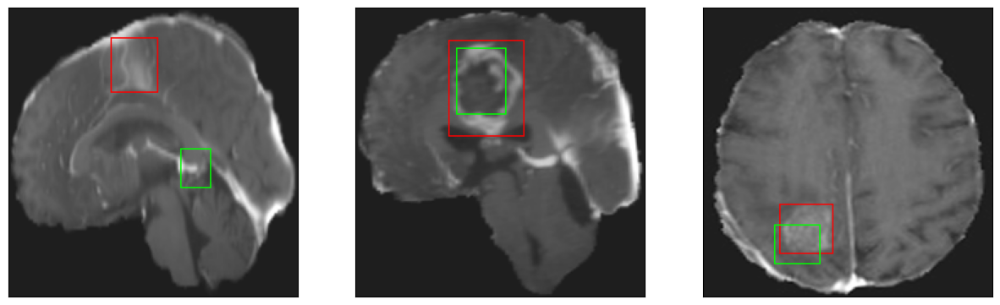

26/26 [==============================] - 8s 306ms/step - loss: 8.0801 - IoU: 0.4686 - val_loss: 9.8021 - val_IoU: 0.4558
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 7.7003 - IoU: 0.4869
Epoch 56: val_IoU did not improve from 0.48389
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


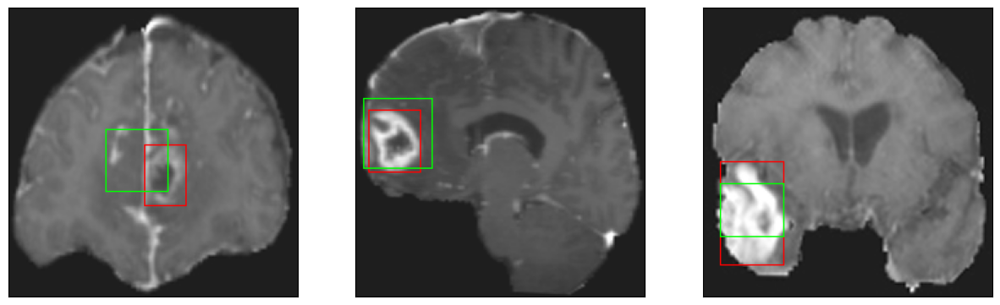

26/26 [==============================] - 8s 305ms/step - loss: 7.7003 - IoU: 0.4869 - val_loss: 10.6629 - val_IoU: 0.4410
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.6422 - IoU: 0.4941
Epoch 57: val_IoU did not improve from 0.48389
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


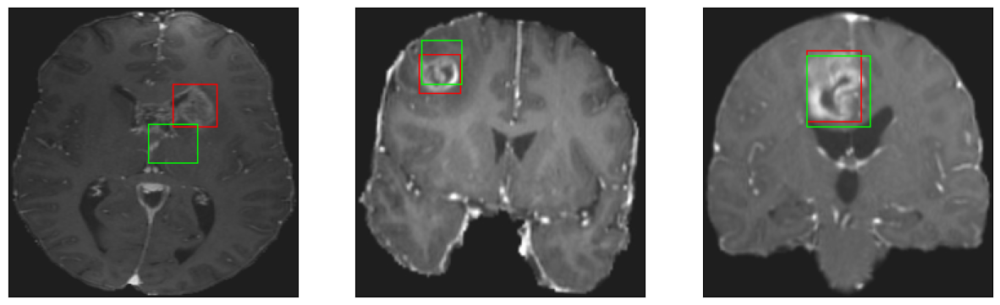

26/26 [==============================] - 7s 276ms/step - loss: 7.6422 - IoU: 0.4941 - val_loss: 10.0333 - val_IoU: 0.4570
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 7.7159 - IoU: 0.4799
Epoch 58: val_IoU did not improve from 0.48389
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


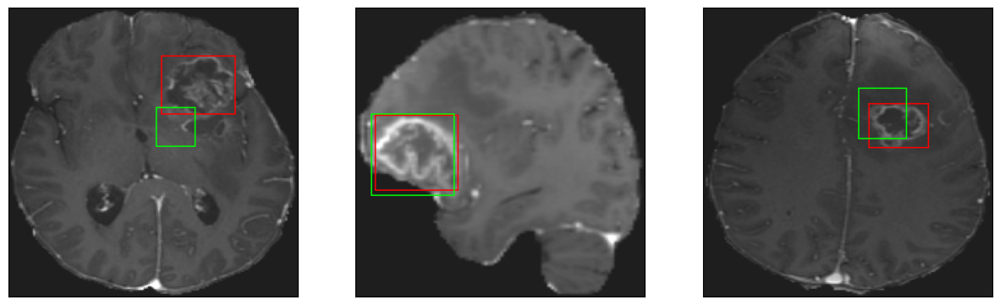

26/26 [==============================] - 8s 310ms/step - loss: 7.7159 - IoU: 0.4799 - val_loss: 9.8751 - val_IoU: 0.4802
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 7.6031 - IoU: 0.4994
Epoch 59: val_IoU improved from 0.48389 to 0.48406, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 48ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4


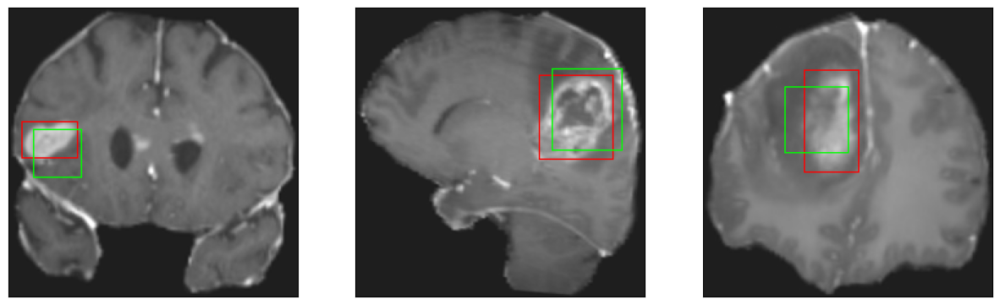

26/26 [==============================] - 29s 1s/step - loss: 7.6031 - IoU: 0.4994 - val_loss: 9.6516 - val_IoU: 0.4841
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 7.7538 - IoU: 0.4930
Epoch 60: val_IoU improved from 0.48406 to 0.49880, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


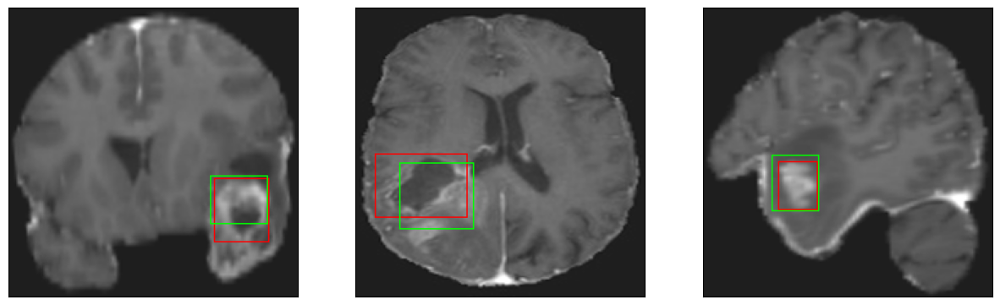

26/26 [==============================] - 22s 853ms/step - loss: 7.7538 - IoU: 0.4930 - val_loss: 9.4301 - val_IoU: 0.4988
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 7.4454 - IoU: 0.5005
Epoch 61: val_IoU did not improve from 0.49880
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


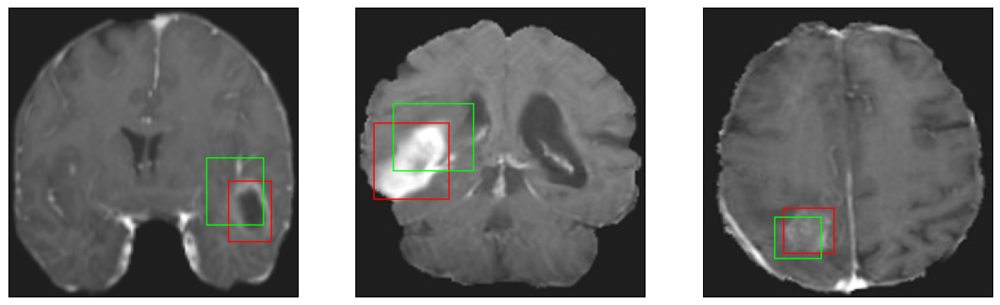

26/26 [==============================] - 7s 263ms/step - loss: 7.4454 - IoU: 0.5005 - val_loss: 10.4678 - val_IoU: 0.4291
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.7305 - IoU: 0.4916
Epoch 62: val_IoU did not improve from 0.49880
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


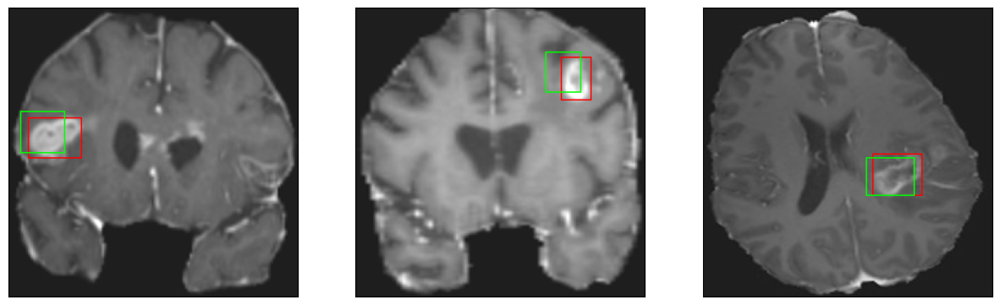

26/26 [==============================] - 8s 294ms/step - loss: 7.7305 - IoU: 0.4916 - val_loss: 10.8284 - val_IoU: 0.4013
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 7.7162 - IoU: 0.4808
Epoch 63: val_IoU did not improve from 0.49880
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


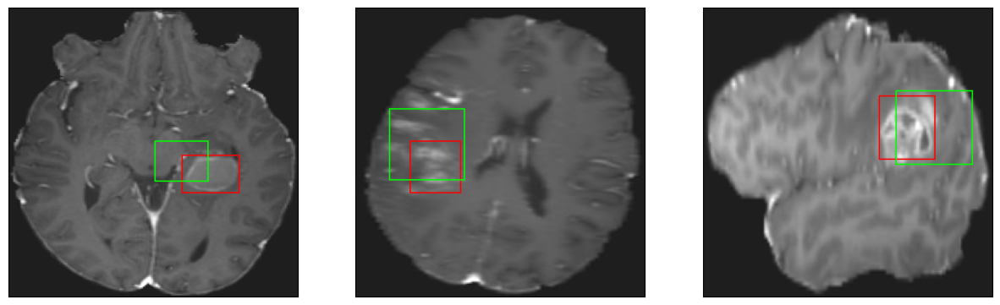

26/26 [==============================] - 8s 302ms/step - loss: 7.7162 - IoU: 0.4808 - val_loss: 10.2429 - val_IoU: 0.4882
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.4642 - IoU: 0.5082
Epoch 64: val_IoU improved from 0.49880 to 0.50762, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 47ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


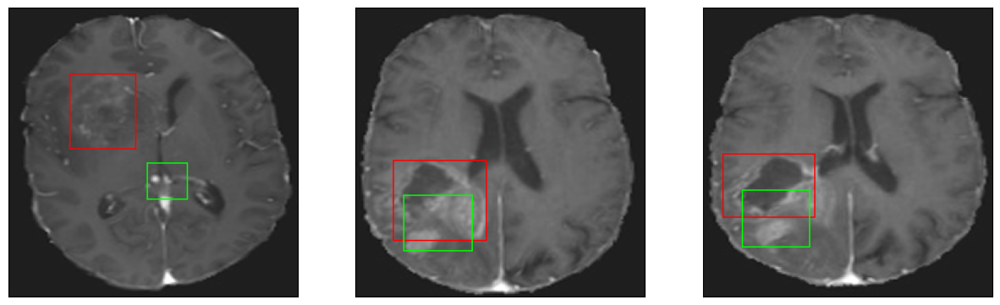

26/26 [==============================] - 39s 2s/step - loss: 7.4642 - IoU: 0.5082 - val_loss: 9.3490 - val_IoU: 0.5076
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 7.2487 - IoU: 0.5041
Epoch 65: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


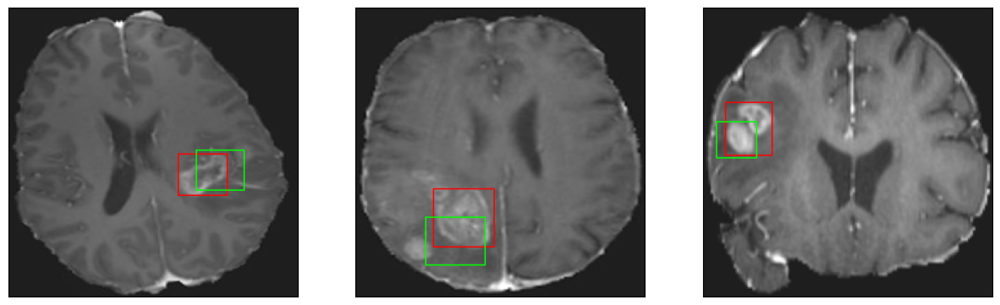

26/26 [==============================] - 8s 308ms/step - loss: 7.2487 - IoU: 0.5041 - val_loss: 10.8954 - val_IoU: 0.4439
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 7.2528 - IoU: 0.5009
Epoch 66: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


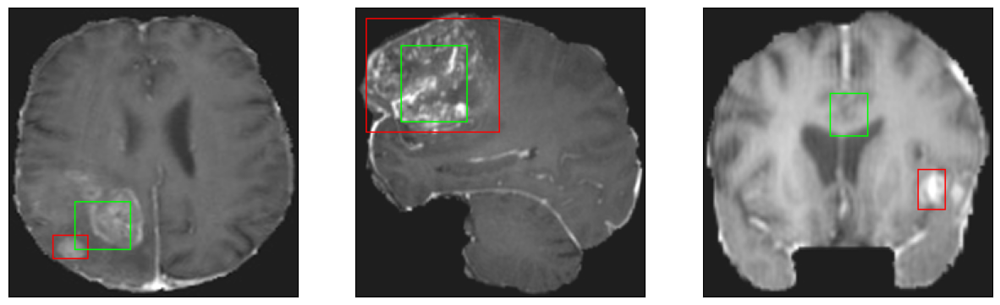

26/26 [==============================] - 8s 328ms/step - loss: 7.2528 - IoU: 0.5009 - val_loss: 10.1362 - val_IoU: 0.4498
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.1165 - IoU: 0.5110
Epoch 67: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


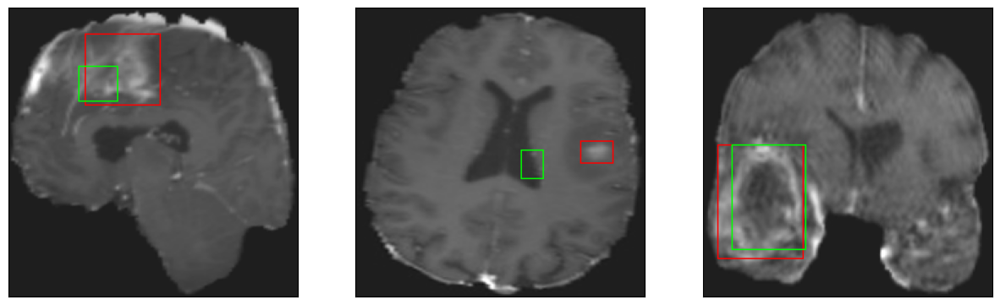

26/26 [==============================] - 8s 312ms/step - loss: 7.1165 - IoU: 0.5110 - val_loss: 9.3317 - val_IoU: 0.4634
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.4884 - IoU: 0.4955
Epoch 68: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


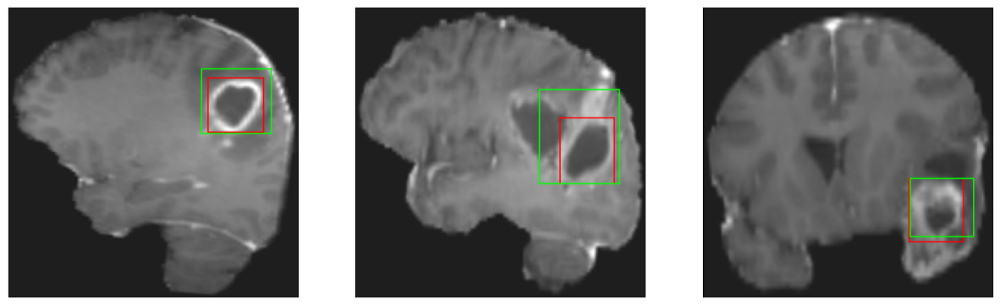

26/26 [==============================] - 8s 317ms/step - loss: 7.4884 - IoU: 0.4955 - val_loss: 9.3350 - val_IoU: 0.4911
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 7.0497 - IoU: 0.5215
Epoch 69: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


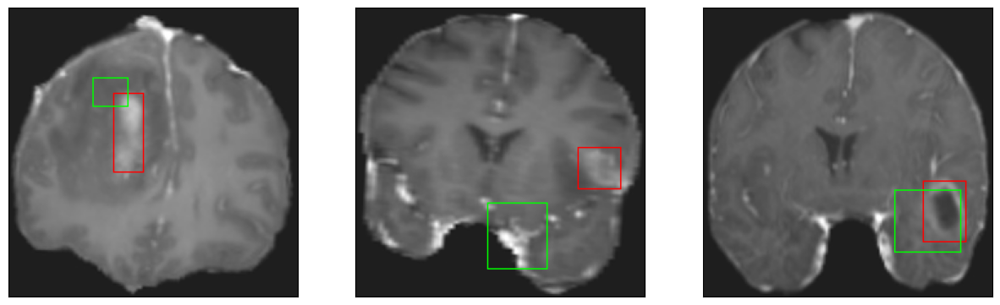

26/26 [==============================] - 7s 270ms/step - loss: 7.0497 - IoU: 0.5215 - val_loss: 10.3807 - val_IoU: 0.4668
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 7.3790 - IoU: 0.4956
Epoch 70: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


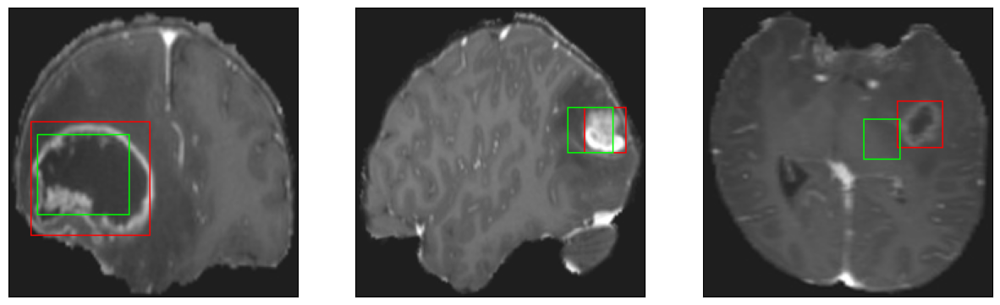

26/26 [==============================] - 7s 286ms/step - loss: 7.3790 - IoU: 0.4956 - val_loss: 9.9139 - val_IoU: 0.4701
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 7.4685 - IoU: 0.4883
Epoch 71: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


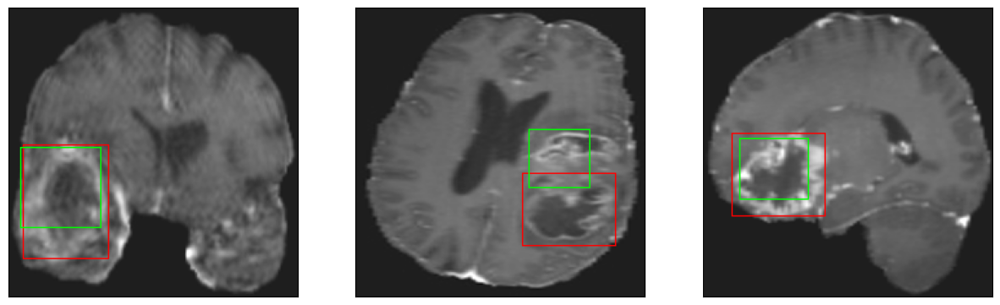

26/26 [==============================] - 8s 291ms/step - loss: 7.4685 - IoU: 0.4883 - val_loss: 10.7561 - val_IoU: 0.4391
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 7.3443 - IoU: 0.4968
Epoch 72: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


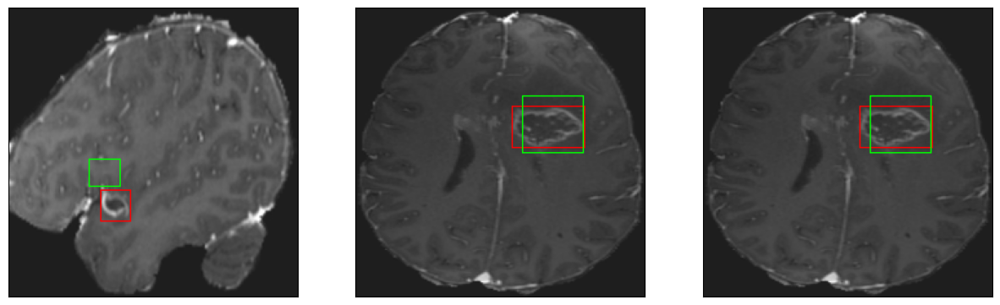

26/26 [==============================] - 8s 297ms/step - loss: 7.3443 - IoU: 0.4968 - val_loss: 9.5639 - val_IoU: 0.4685
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 6.9802 - IoU: 0.5180
Epoch 73: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


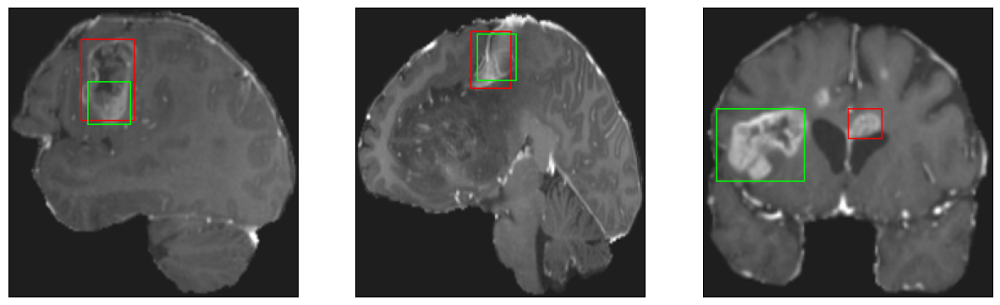

26/26 [==============================] - 8s 308ms/step - loss: 6.9802 - IoU: 0.5180 - val_loss: 9.4894 - val_IoU: 0.4892
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 7.0640 - IoU: 0.5167
Epoch 74: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4


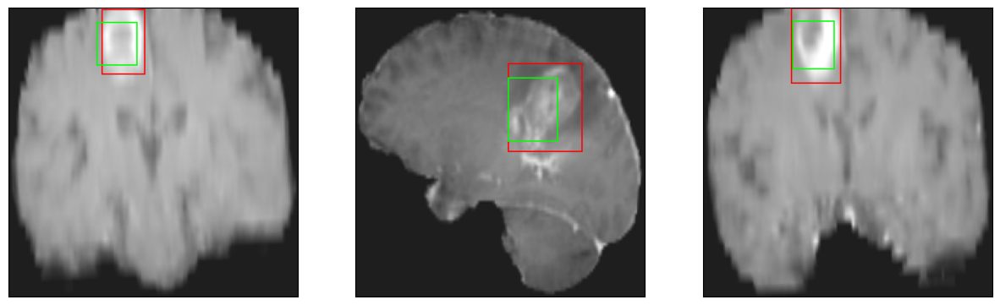

26/26 [==============================] - 8s 296ms/step - loss: 7.0640 - IoU: 0.5167 - val_loss: 10.1920 - val_IoU: 0.4458
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 7.5494 - IoU: 0.4926
Epoch 75: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


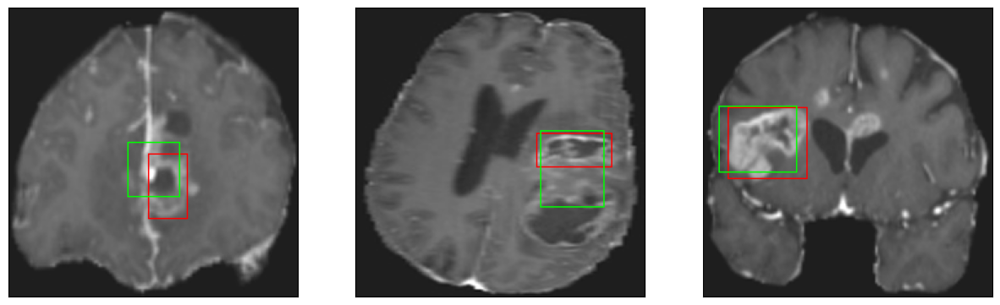

26/26 [==============================] - 8s 306ms/step - loss: 7.5494 - IoU: 0.4926 - val_loss: 10.3472 - val_IoU: 0.4641
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.1590 - IoU: 0.5042
Epoch 76: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


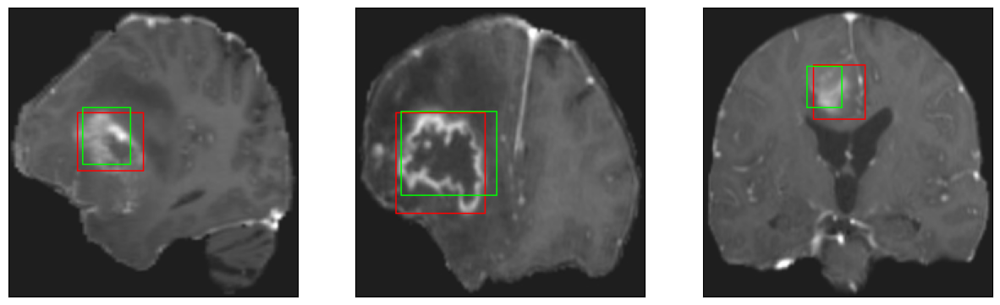

26/26 [==============================] - 8s 301ms/step - loss: 7.1590 - IoU: 0.5042 - val_loss: 9.3818 - val_IoU: 0.4812
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 6.8163 - IoU: 0.5234
Epoch 77: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


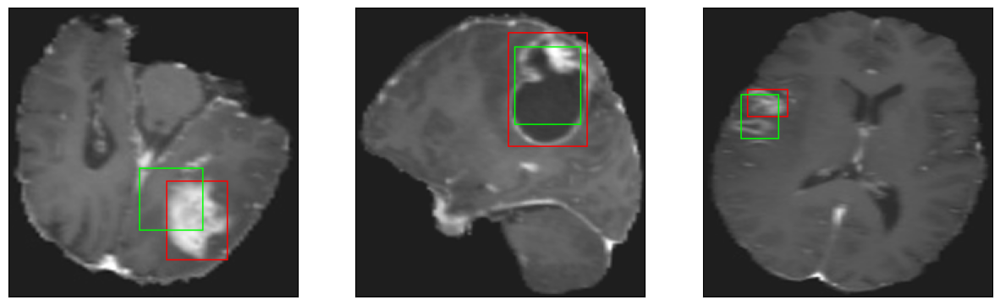

26/26 [==============================] - 7s 286ms/step - loss: 6.8163 - IoU: 0.5234 - val_loss: 9.9514 - val_IoU: 0.4586
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 6.9423 - IoU: 0.5185
Epoch 78: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


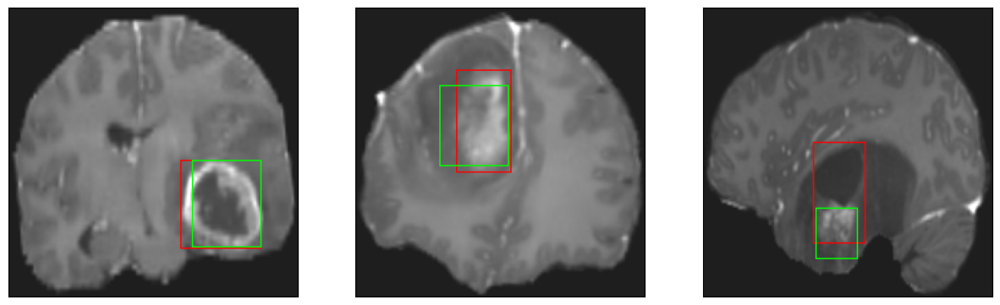

26/26 [==============================] - 8s 300ms/step - loss: 6.9423 - IoU: 0.5185 - val_loss: 9.7892 - val_IoU: 0.4613
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 7.0921 - IoU: 0.5048
Epoch 79: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


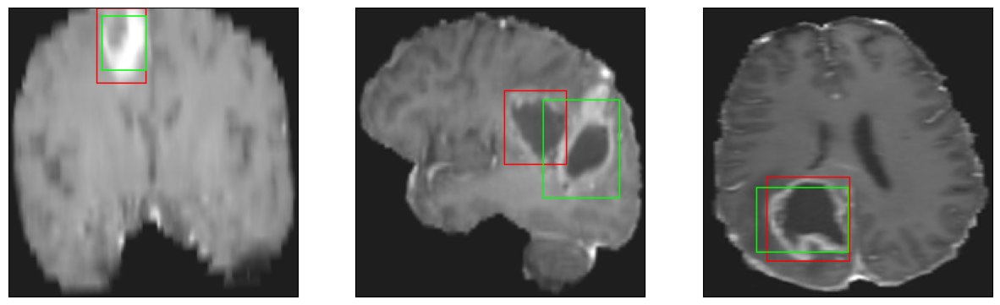

26/26 [==============================] - 8s 311ms/step - loss: 7.0921 - IoU: 0.5048 - val_loss: 9.7358 - val_IoU: 0.4592
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 7.1365 - IoU: 0.5106
Epoch 80: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


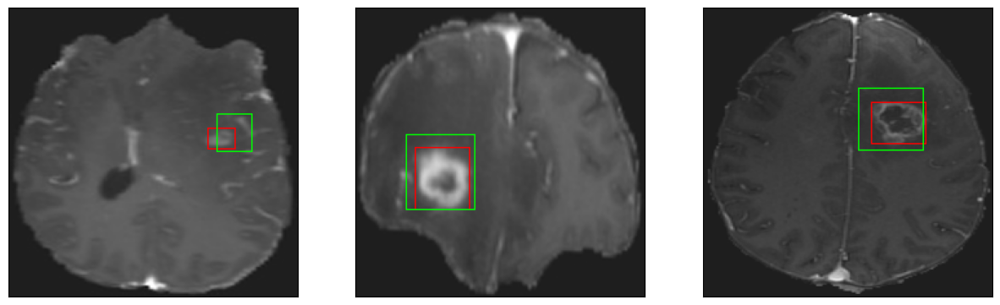

26/26 [==============================] - 8s 293ms/step - loss: 7.1365 - IoU: 0.5106 - val_loss: 9.4520 - val_IoU: 0.4976
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 6.5812 - IoU: 0.5351
Epoch 81: val_IoU did not improve from 0.50762
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


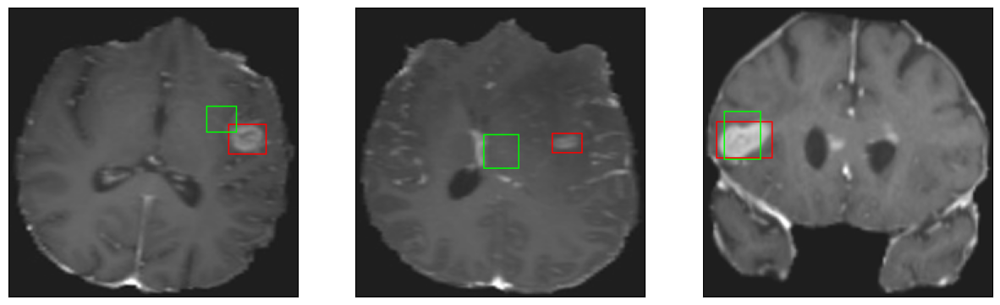

26/26 [==============================] - 7s 275ms/step - loss: 6.5812 - IoU: 0.5351 - val_loss: 9.7911 - val_IoU: 0.4646
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 6.4344 - IoU: 0.5387
Epoch 82: val_IoU improved from 0.50762 to 0.50925, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


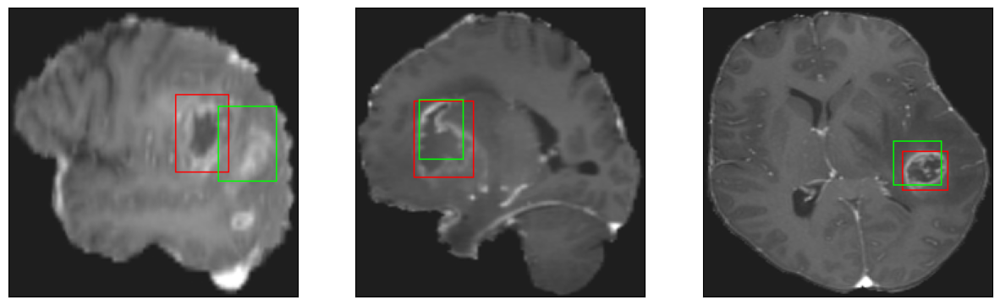

26/26 [==============================] - 41s 2s/step - loss: 6.4344 - IoU: 0.5387 - val_loss: 9.2812 - val_IoU: 0.5092
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 6.9874 - IoU: 0.5190
Epoch 83: val_IoU did not improve from 0.50925
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 46ms/step
4


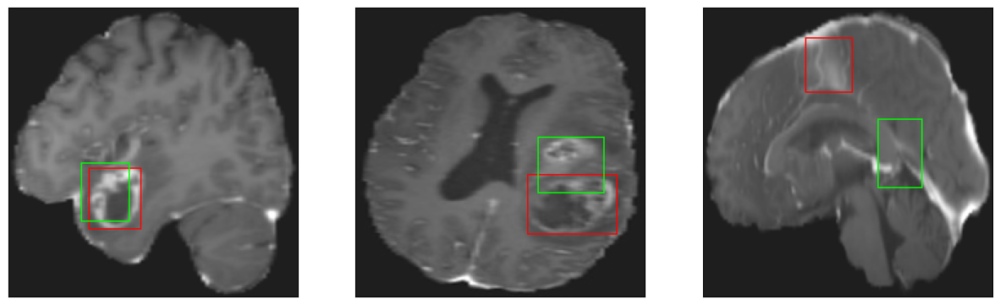

26/26 [==============================] - 8s 326ms/step - loss: 6.9874 - IoU: 0.5190 - val_loss: 9.3856 - val_IoU: 0.4950
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 6.6951 - IoU: 0.5345
Epoch 84: val_IoU improved from 0.50925 to 0.52742, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 46ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


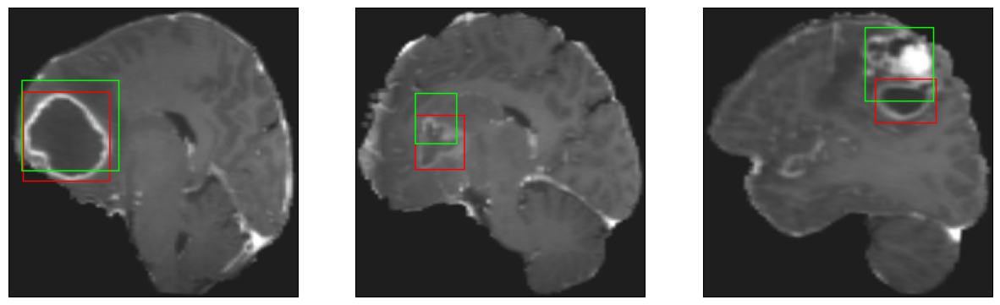

26/26 [==============================] - 20s 794ms/step - loss: 6.6951 - IoU: 0.5345 - val_loss: 9.0302 - val_IoU: 0.5274
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.5607 - IoU: 0.5407
Epoch 85: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 47ms/step
4


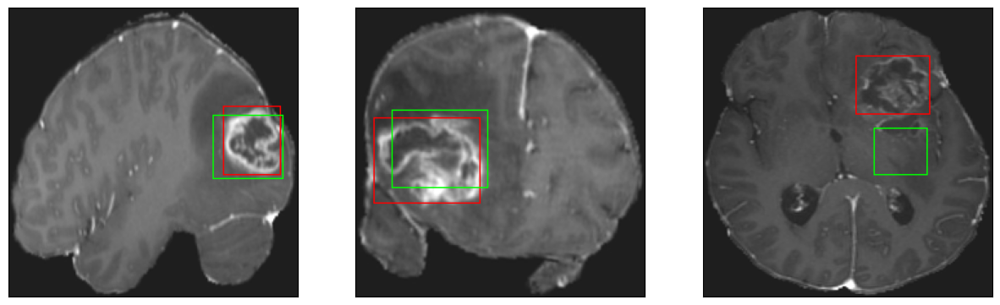

26/26 [==============================] - 9s 334ms/step - loss: 6.5607 - IoU: 0.5407 - val_loss: 9.5522 - val_IoU: 0.4854
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.4704 - IoU: 0.5402
Epoch 86: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4


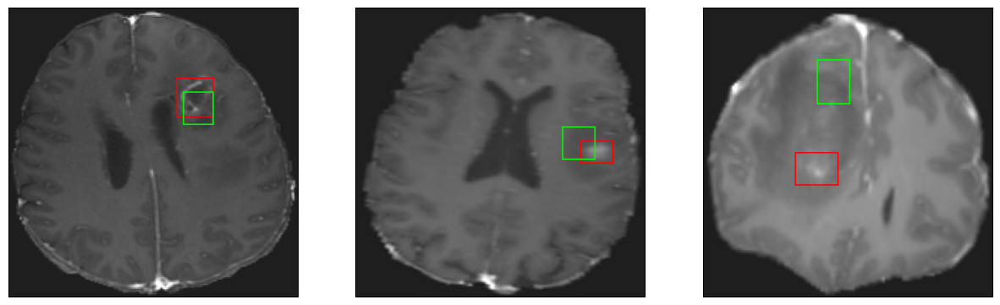

26/26 [==============================] - 8s 307ms/step - loss: 6.4704 - IoU: 0.5402 - val_loss: 9.5666 - val_IoU: 0.5096
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 6.5017 - IoU: 0.5305
Epoch 87: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


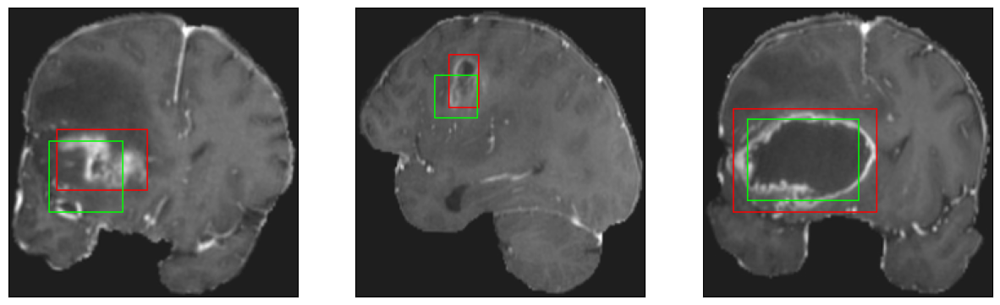

26/26 [==============================] - 8s 291ms/step - loss: 6.5017 - IoU: 0.5305 - val_loss: 9.4024 - val_IoU: 0.5068
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 6.2901 - IoU: 0.5484
Epoch 88: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


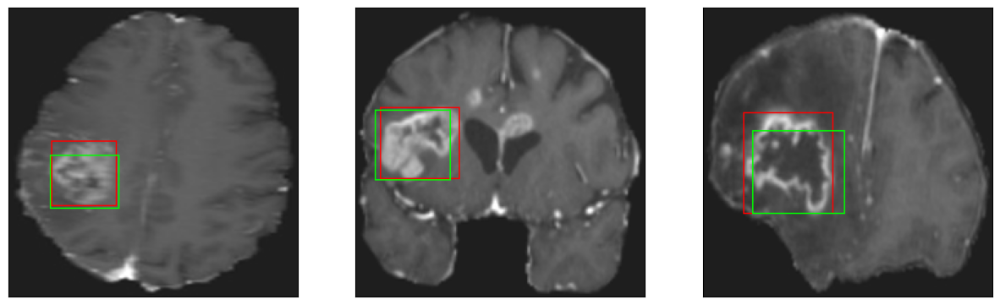

26/26 [==============================] - 8s 297ms/step - loss: 6.2901 - IoU: 0.5484 - val_loss: 10.3604 - val_IoU: 0.4533
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.2674 - IoU: 0.5517
Epoch 89: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


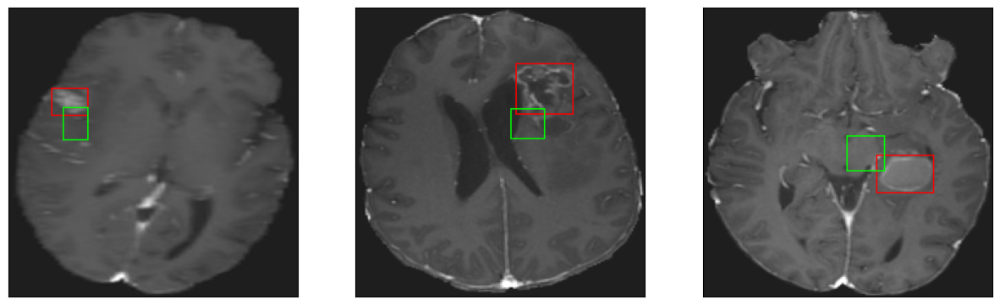

26/26 [==============================] - 8s 299ms/step - loss: 6.2674 - IoU: 0.5517 - val_loss: 9.1419 - val_IoU: 0.5003
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.4541 - IoU: 0.5416
Epoch 90: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 44ms/step
4


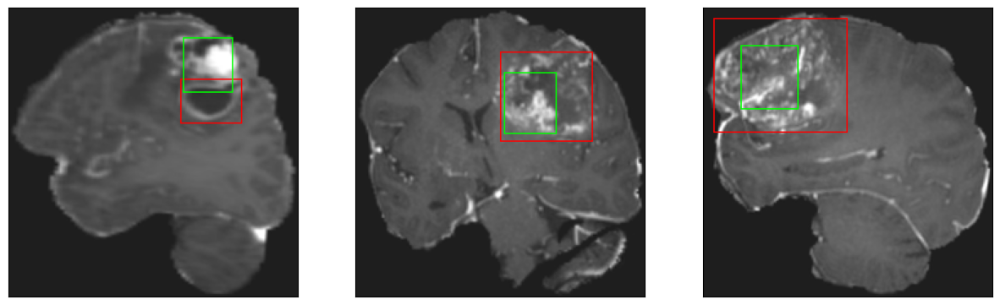

26/26 [==============================] - 7s 282ms/step - loss: 6.4541 - IoU: 0.5416 - val_loss: 10.4741 - val_IoU: 0.4161
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.6625 - IoU: 0.5367
Epoch 91: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


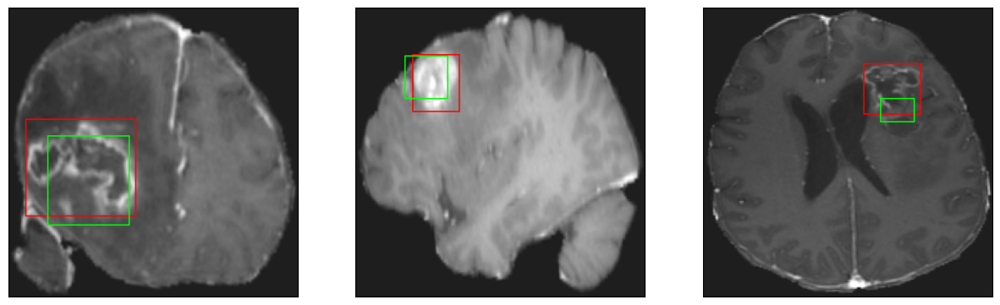

26/26 [==============================] - 7s 269ms/step - loss: 6.6625 - IoU: 0.5367 - val_loss: 9.8886 - val_IoU: 0.4622
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.3795 - IoU: 0.5466
Epoch 92: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


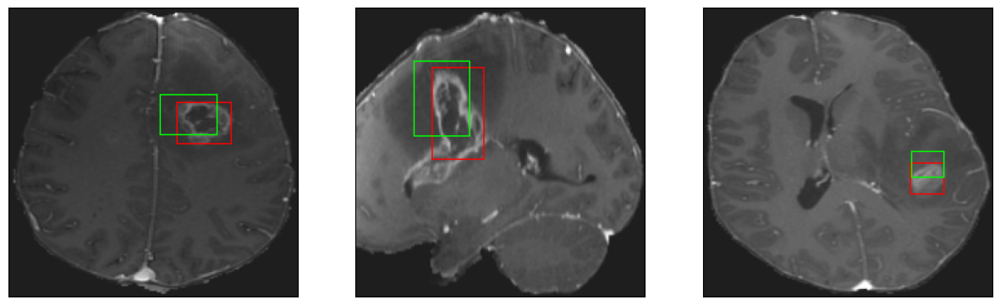

26/26 [==============================] - 8s 295ms/step - loss: 6.3795 - IoU: 0.5466 - val_loss: 9.7710 - val_IoU: 0.4851
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.2505 - IoU: 0.5485
Epoch 93: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


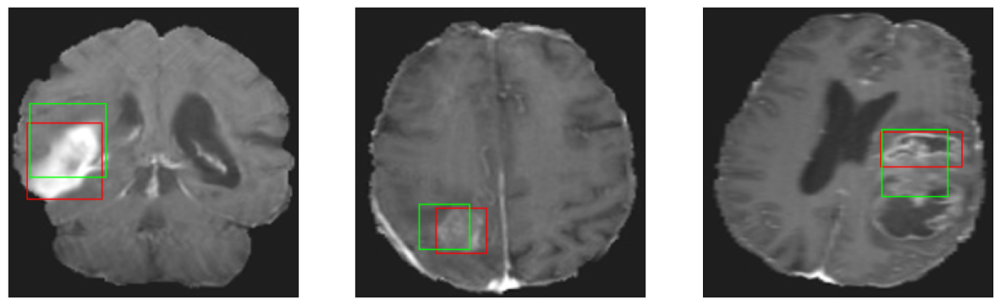

26/26 [==============================] - 8s 294ms/step - loss: 6.2505 - IoU: 0.5485 - val_loss: 9.8691 - val_IoU: 0.4696
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.4939 - IoU: 0.5378
Epoch 94: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


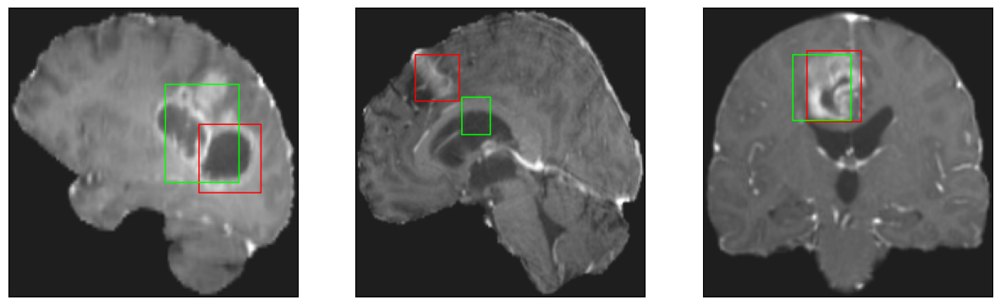

26/26 [==============================] - 8s 294ms/step - loss: 6.4939 - IoU: 0.5378 - val_loss: 10.1090 - val_IoU: 0.4603
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.4795 - IoU: 0.5378
Epoch 95: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


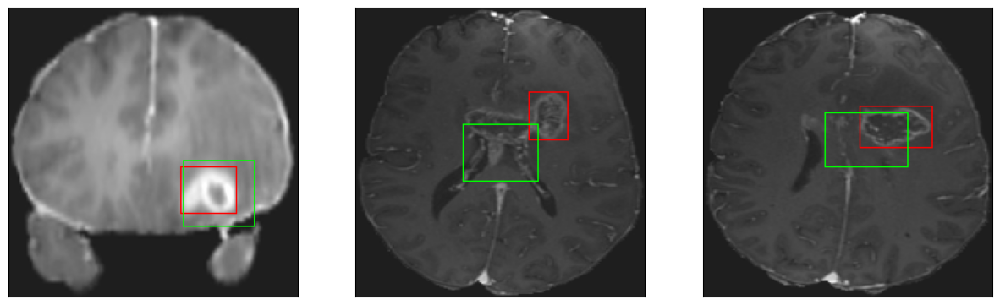

26/26 [==============================] - 8s 294ms/step - loss: 6.4795 - IoU: 0.5378 - val_loss: 9.7744 - val_IoU: 0.4999
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 7.1964 - IoU: 0.5275
Epoch 96: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


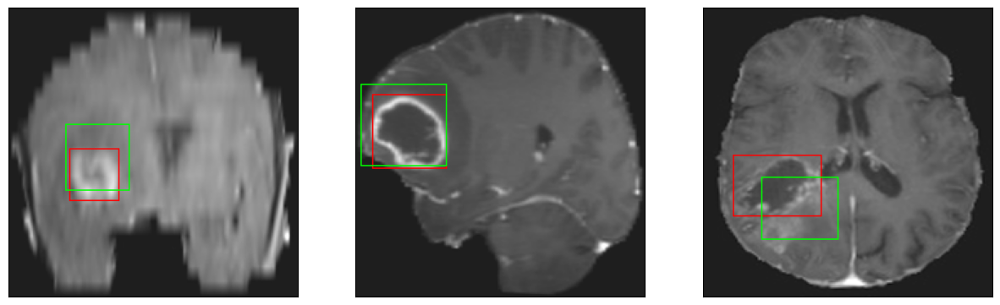

26/26 [==============================] - 8s 290ms/step - loss: 7.1964 - IoU: 0.5275 - val_loss: 10.0196 - val_IoU: 0.4622
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.4382 - IoU: 0.5459
Epoch 97: val_IoU did not improve from 0.52742
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


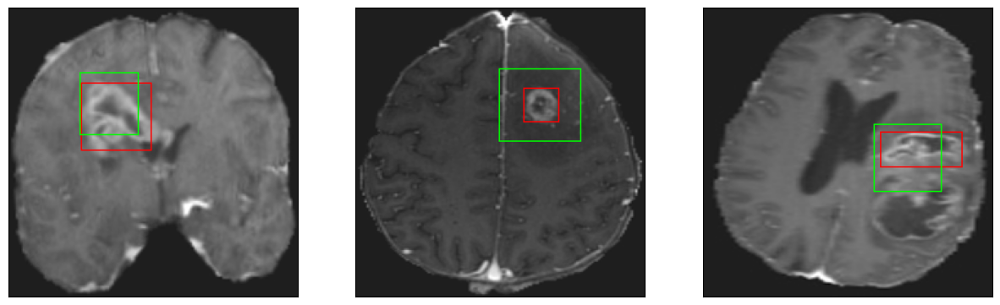

26/26 [==============================] - 8s 312ms/step - loss: 6.4382 - IoU: 0.5459 - val_loss: 10.1726 - val_IoU: 0.4598
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.2222 - IoU: 0.5437
Epoch 98: val_IoU improved from 0.52742 to 0.52942, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


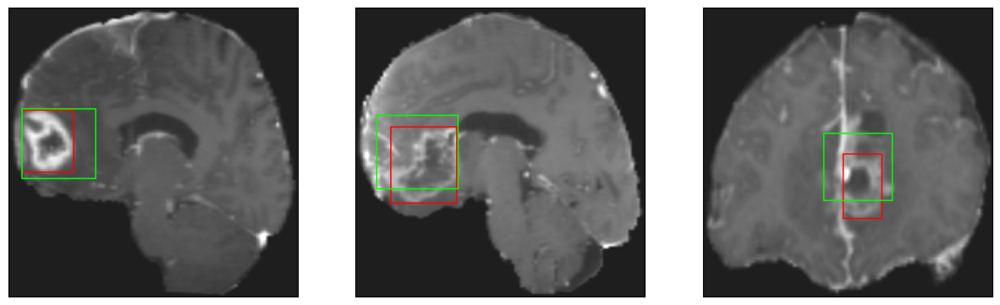

26/26 [==============================] - 29s 1s/step - loss: 6.2222 - IoU: 0.5437 - val_loss: 8.7813 - val_IoU: 0.5294
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.6596 - IoU: 0.5300
Epoch 99: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


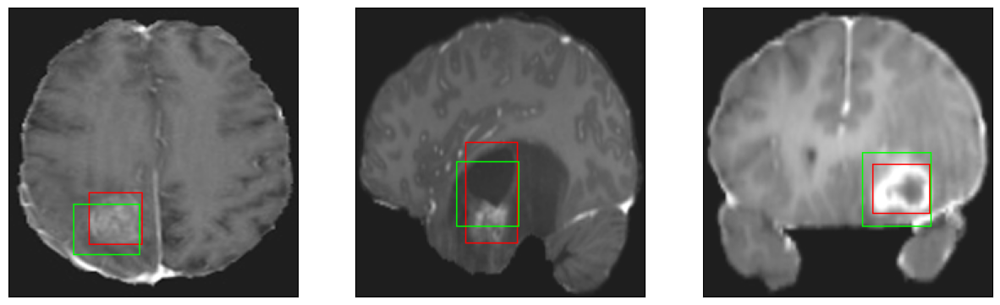

26/26 [==============================] - 8s 314ms/step - loss: 6.6596 - IoU: 0.5300 - val_loss: 9.7240 - val_IoU: 0.5021
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.6609 - IoU: 0.5299
Epoch 100: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


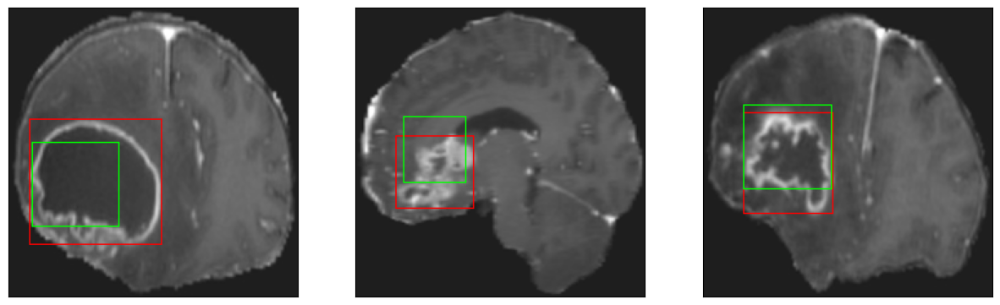

26/26 [==============================] - 8s 314ms/step - loss: 6.6609 - IoU: 0.5299 - val_loss: 9.1452 - val_IoU: 0.4846
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.4091 - IoU: 0.5401
Epoch 101: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


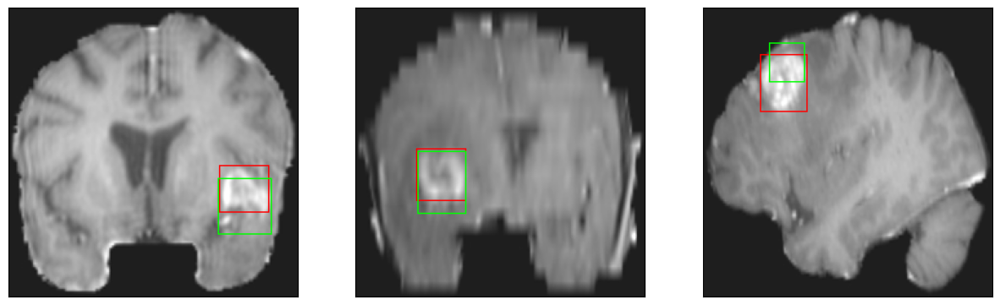

26/26 [==============================] - 9s 368ms/step - loss: 6.4091 - IoU: 0.5401 - val_loss: 9.2312 - val_IoU: 0.4988
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.0968 - IoU: 0.5647
Epoch 102: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 46ms/step
4


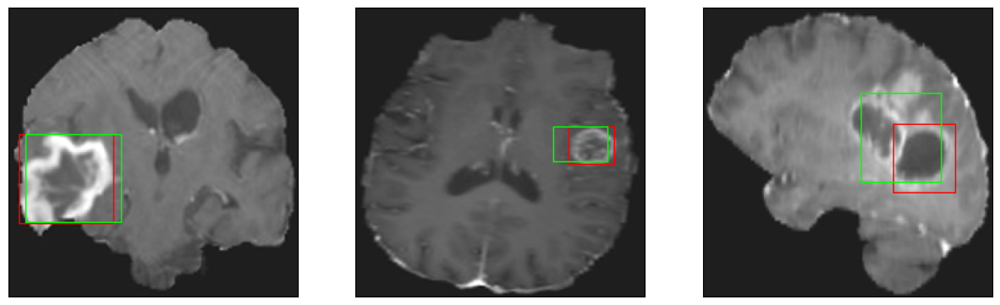

26/26 [==============================] - 8s 320ms/step - loss: 6.0968 - IoU: 0.5647 - val_loss: 9.2756 - val_IoU: 0.5000
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.2911 - IoU: 0.5519
Epoch 103: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


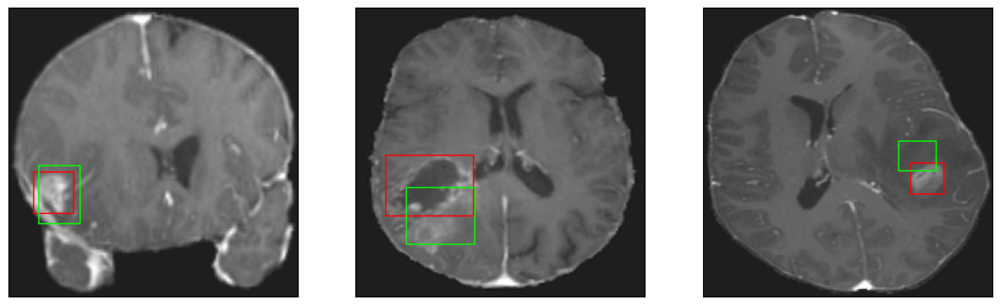

26/26 [==============================] - 8s 325ms/step - loss: 6.2911 - IoU: 0.5519 - val_loss: 9.2989 - val_IoU: 0.5006
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.0541 - IoU: 0.5628
Epoch 104: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 41ms/step
4


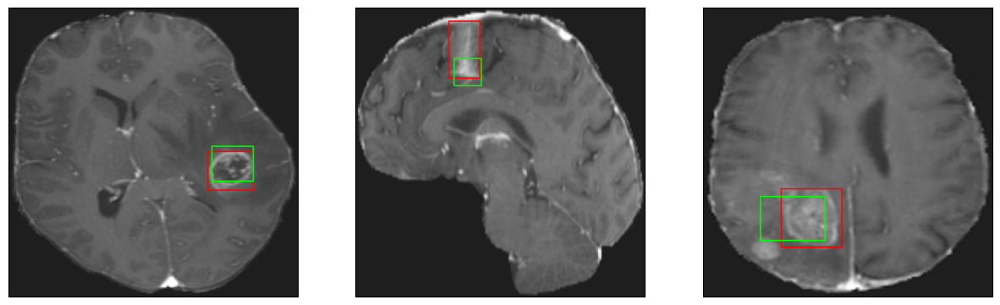

26/26 [==============================] - 8s 292ms/step - loss: 6.0541 - IoU: 0.5628 - val_loss: 11.2361 - val_IoU: 0.4422
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 6.1499 - IoU: 0.5533
Epoch 105: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


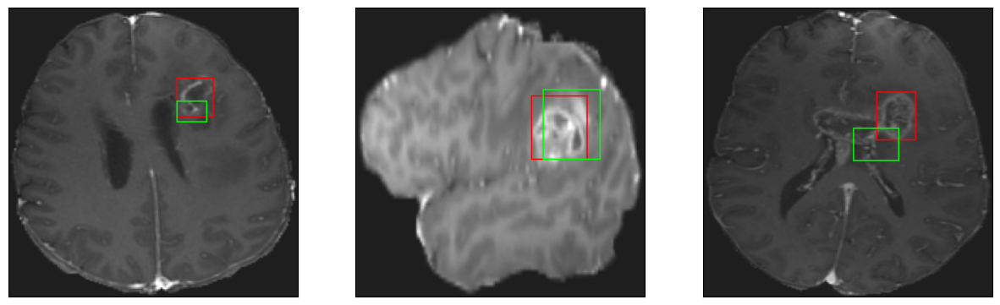

26/26 [==============================] - 8s 319ms/step - loss: 6.1499 - IoU: 0.5533 - val_loss: 9.1011 - val_IoU: 0.5084
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.2899 - IoU: 0.5411
Epoch 106: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


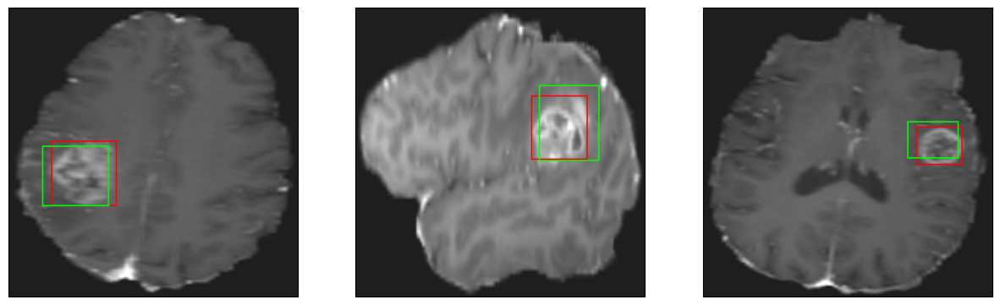

26/26 [==============================] - 7s 287ms/step - loss: 6.2899 - IoU: 0.5411 - val_loss: 9.5839 - val_IoU: 0.4832
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.2187 - IoU: 0.5455
Epoch 107: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 45ms/step
4


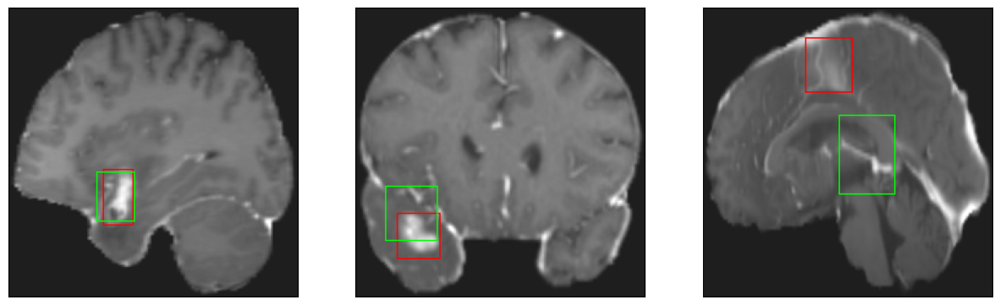

26/26 [==============================] - 8s 297ms/step - loss: 6.2187 - IoU: 0.5455 - val_loss: 9.4641 - val_IoU: 0.4801
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 6.2091 - IoU: 0.5549
Epoch 108: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


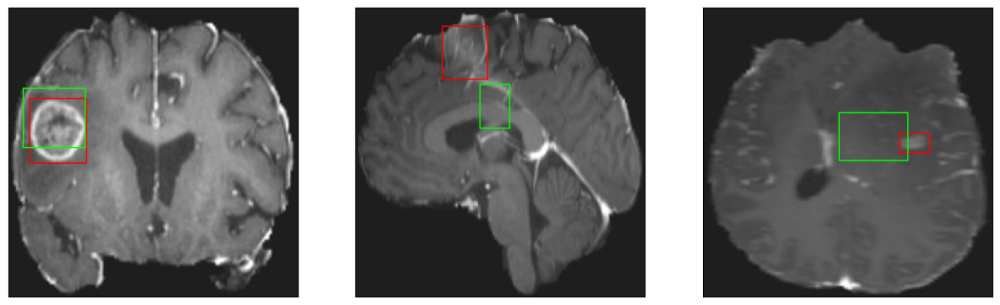

26/26 [==============================] - 8s 310ms/step - loss: 6.2091 - IoU: 0.5549 - val_loss: 9.5500 - val_IoU: 0.4879
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.1128 - IoU: 0.5538
Epoch 109: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


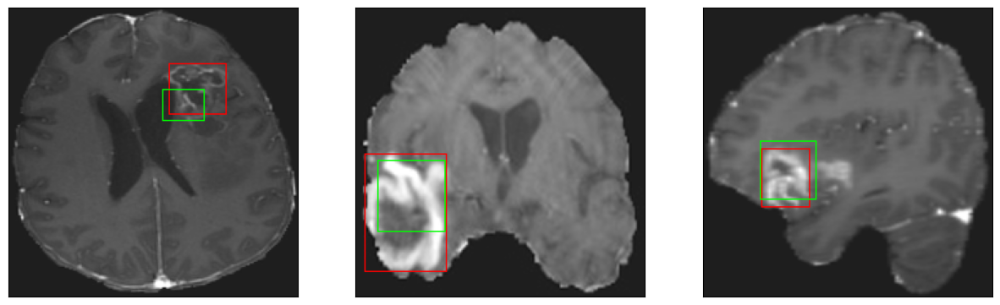

26/26 [==============================] - 8s 305ms/step - loss: 6.1128 - IoU: 0.5538 - val_loss: 9.7912 - val_IoU: 0.4764
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.0161 - IoU: 0.5721
Epoch 110: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


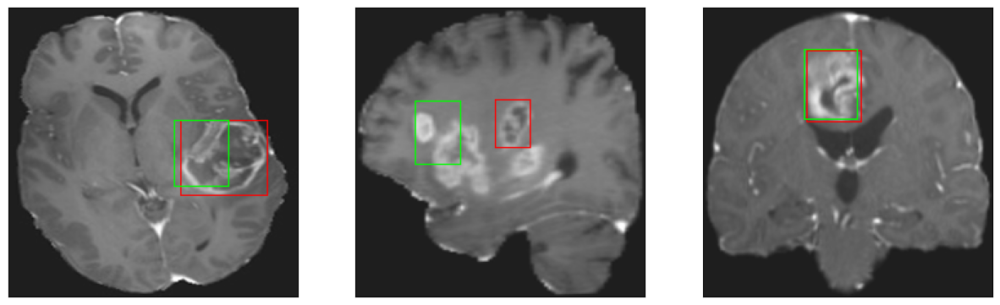

26/26 [==============================] - 8s 299ms/step - loss: 6.0161 - IoU: 0.5721 - val_loss: 10.5607 - val_IoU: 0.4287
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.2257 - IoU: 0.5505
Epoch 111: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 45ms/step
4


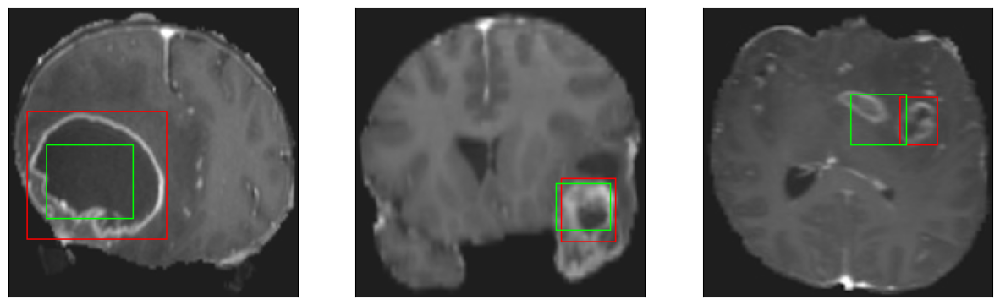

26/26 [==============================] - 8s 306ms/step - loss: 6.2257 - IoU: 0.5505 - val_loss: 9.7665 - val_IoU: 0.4853
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.1414 - IoU: 0.5445
Epoch 112: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4


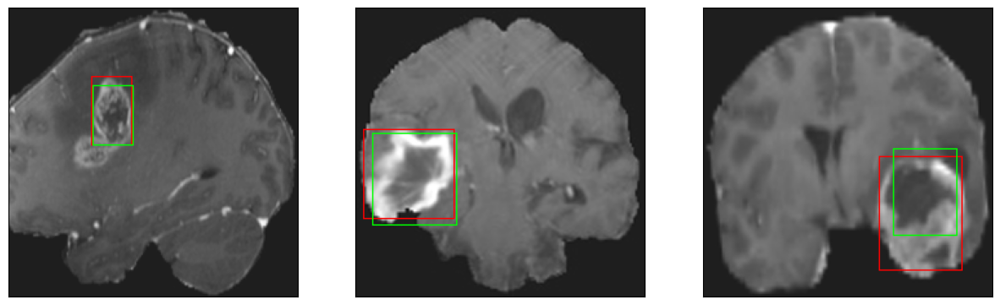

26/26 [==============================] - 8s 322ms/step - loss: 6.1414 - IoU: 0.5445 - val_loss: 9.1534 - val_IoU: 0.4989
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 6.2242 - IoU: 0.5508
Epoch 113: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


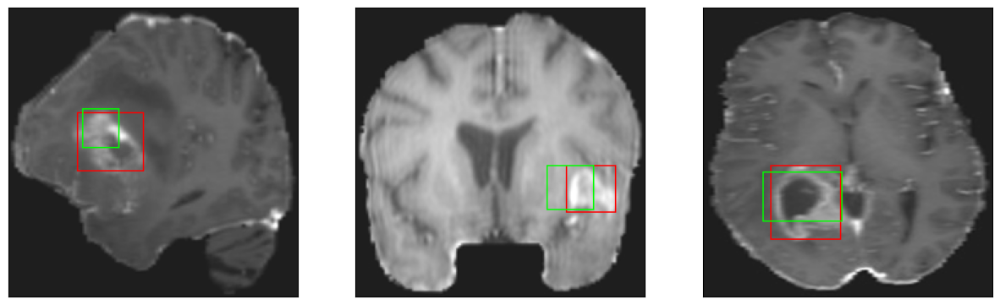

26/26 [==============================] - 8s 314ms/step - loss: 6.2242 - IoU: 0.5508 - val_loss: 9.9635 - val_IoU: 0.4678
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.0278 - IoU: 0.5546
Epoch 114: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4


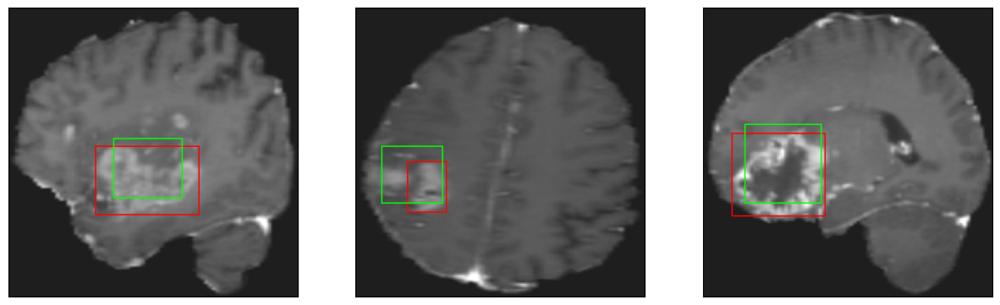

26/26 [==============================] - 9s 347ms/step - loss: 6.0278 - IoU: 0.5546 - val_loss: 8.9033 - val_IoU: 0.5134
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 6.0853 - IoU: 0.5534
Epoch 115: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 40ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


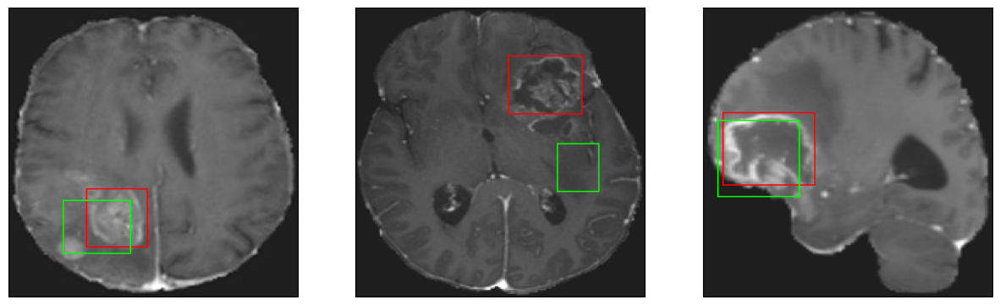

26/26 [==============================] - 8s 304ms/step - loss: 6.0853 - IoU: 0.5534 - val_loss: 10.5118 - val_IoU: 0.4549
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 6.2024 - IoU: 0.5580
Epoch 116: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


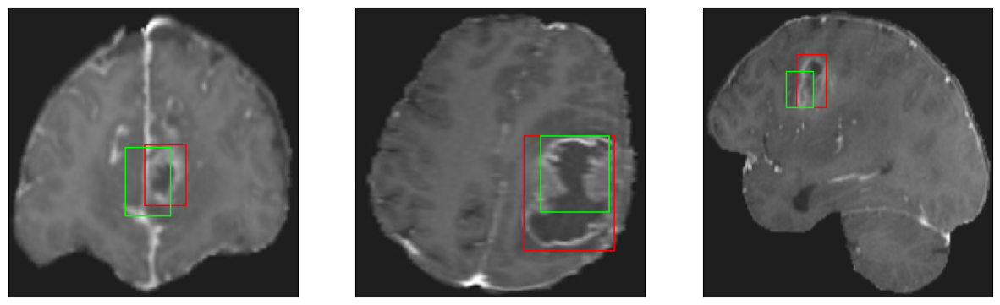

26/26 [==============================] - 8s 329ms/step - loss: 6.2024 - IoU: 0.5580 - val_loss: 8.5314 - val_IoU: 0.5167
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 5.9517 - IoU: 0.5567
Epoch 117: val_IoU did not improve from 0.52942
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


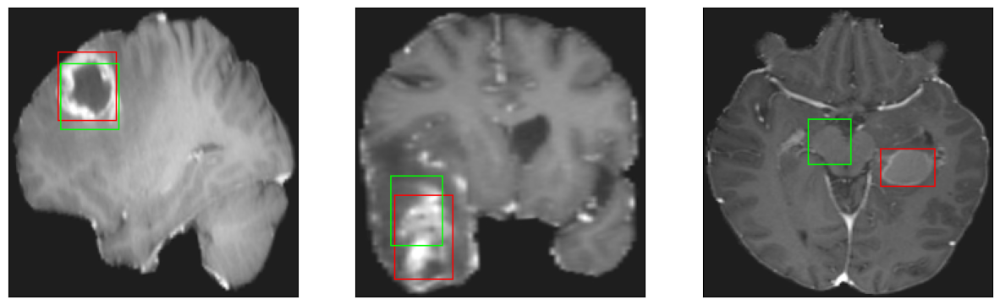

26/26 [==============================] - 8s 301ms/step - loss: 5.9517 - IoU: 0.5567 - val_loss: 9.0261 - val_IoU: 0.4912
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.1105 - IoU: 0.5575
Epoch 118: val_IoU improved from 0.52942 to 0.55032, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


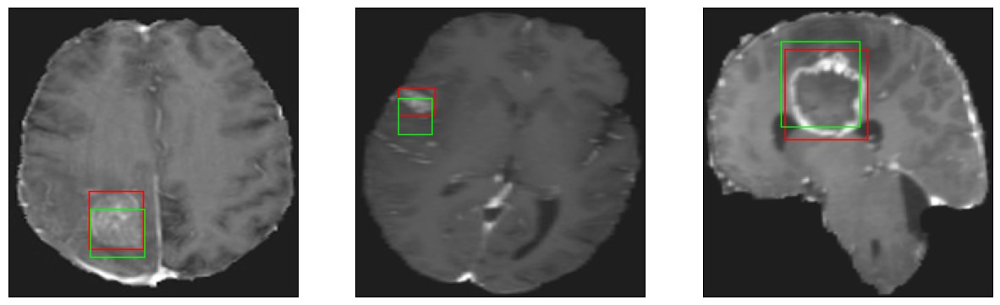

26/26 [==============================] - 40s 2s/step - loss: 6.1105 - IoU: 0.5575 - val_loss: 8.4014 - val_IoU: 0.5503
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 5.8133 - IoU: 0.5744
Epoch 119: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 45ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 45ms/step
4


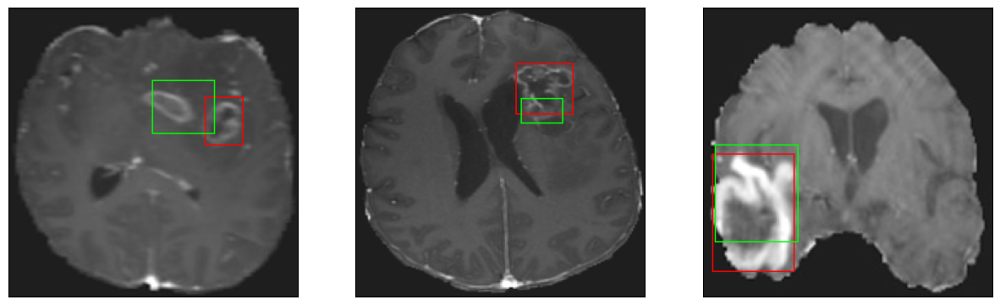

26/26 [==============================] - 8s 329ms/step - loss: 5.8133 - IoU: 0.5744 - val_loss: 9.3065 - val_IoU: 0.5046
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 6.0090 - IoU: 0.5594
Epoch 120: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 40ms/step
4


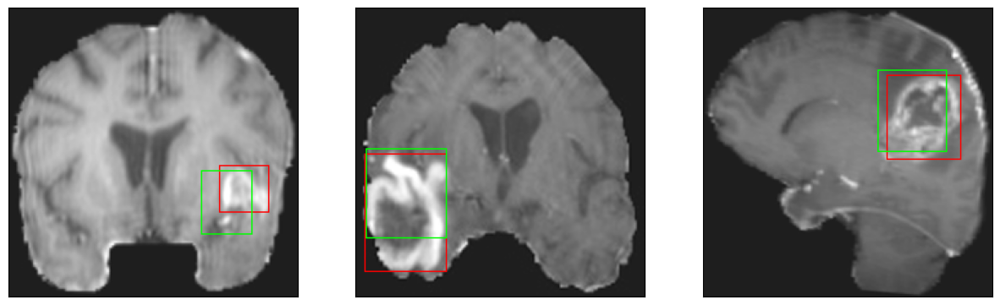

26/26 [==============================] - 8s 291ms/step - loss: 6.0090 - IoU: 0.5594 - val_loss: 9.0313 - val_IoU: 0.5141
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 6.1812 - IoU: 0.5485
Epoch 121: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


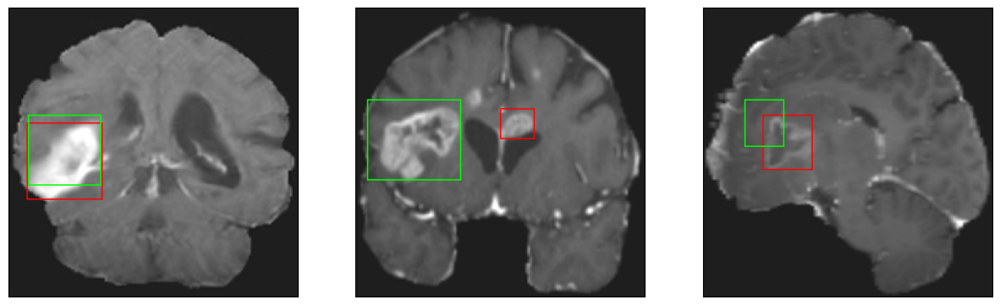

26/26 [==============================] - 8s 309ms/step - loss: 6.1812 - IoU: 0.5485 - val_loss: 9.4040 - val_IoU: 0.5071
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 6.2347 - IoU: 0.5487
Epoch 122: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4


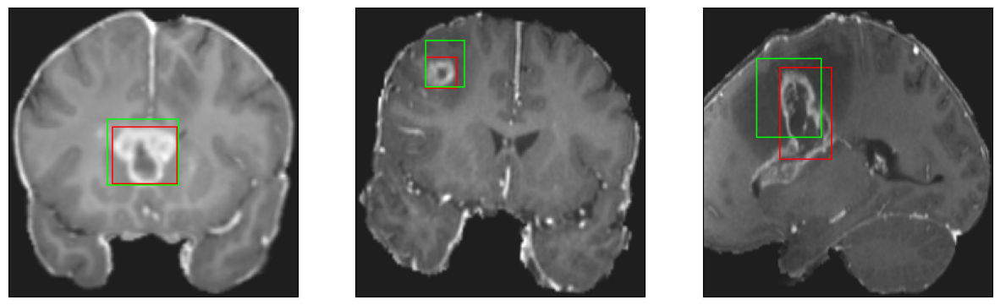

26/26 [==============================] - 8s 298ms/step - loss: 6.2347 - IoU: 0.5487 - val_loss: 9.1465 - val_IoU: 0.5008
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 6.1955 - IoU: 0.5500
Epoch 123: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 42ms/step
4


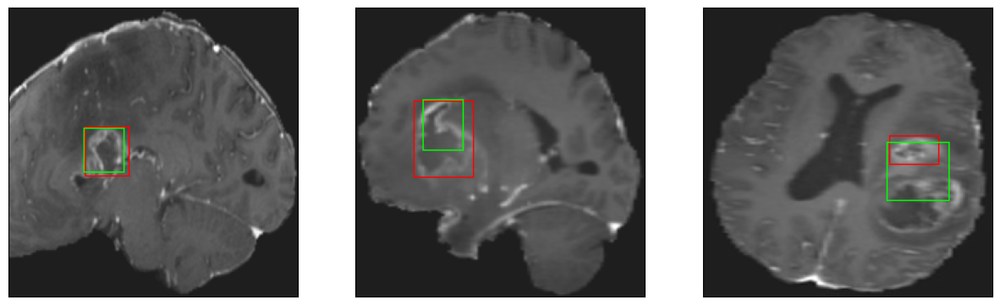

26/26 [==============================] - 7s 281ms/step - loss: 6.1955 - IoU: 0.5500 - val_loss: 8.6889 - val_IoU: 0.5458
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 5.6311 - IoU: 0.5752
Epoch 124: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


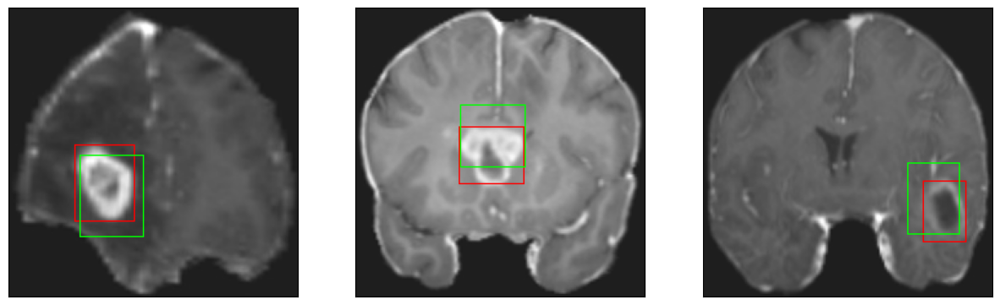

26/26 [==============================] - 8s 307ms/step - loss: 5.6311 - IoU: 0.5752 - val_loss: 9.7518 - val_IoU: 0.4799
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 5.9014 - IoU: 0.5661
Epoch 125: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


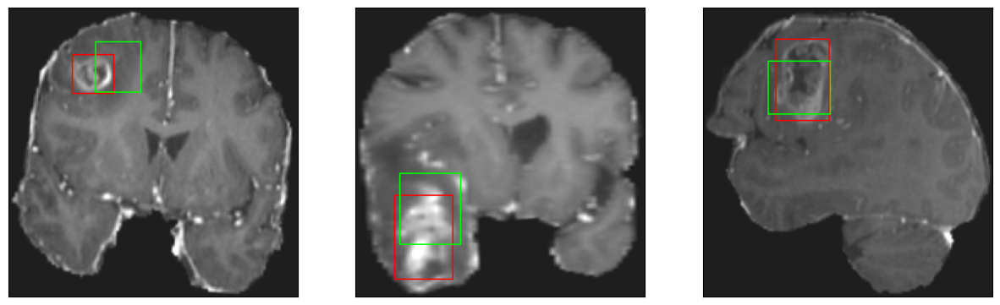

26/26 [==============================] - 7s 284ms/step - loss: 5.9014 - IoU: 0.5661 - val_loss: 9.5599 - val_IoU: 0.4885
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 5.8787 - IoU: 0.5596
Epoch 126: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


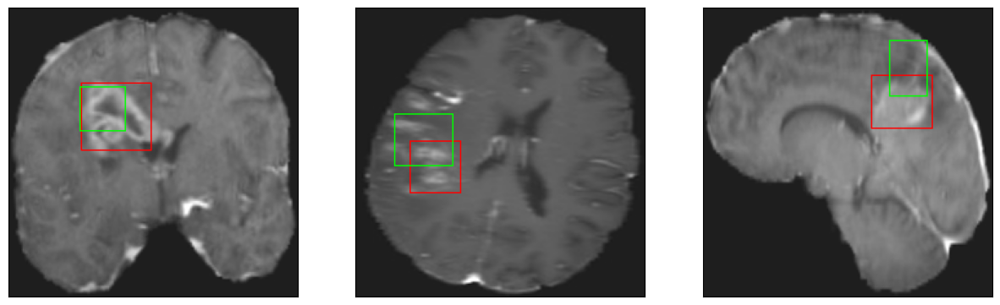

26/26 [==============================] - 8s 300ms/step - loss: 5.8787 - IoU: 0.5596 - val_loss: 9.3777 - val_IoU: 0.4715
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 5.8834 - IoU: 0.5820
Epoch 127: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4


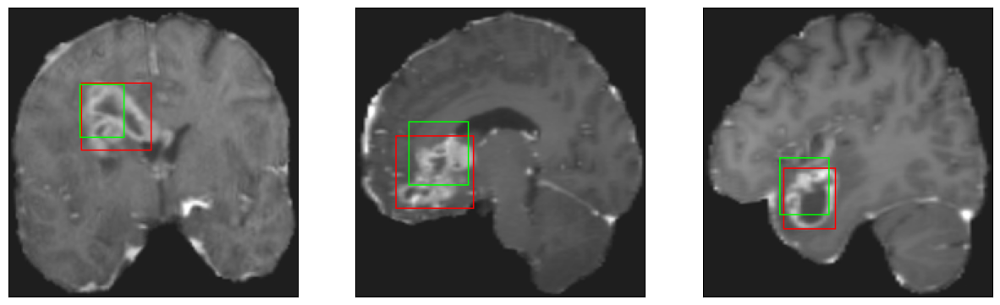

26/26 [==============================] - 7s 289ms/step - loss: 5.8834 - IoU: 0.5820 - val_loss: 9.1973 - val_IoU: 0.4848
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 6.1286 - IoU: 0.5489
Epoch 128: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4


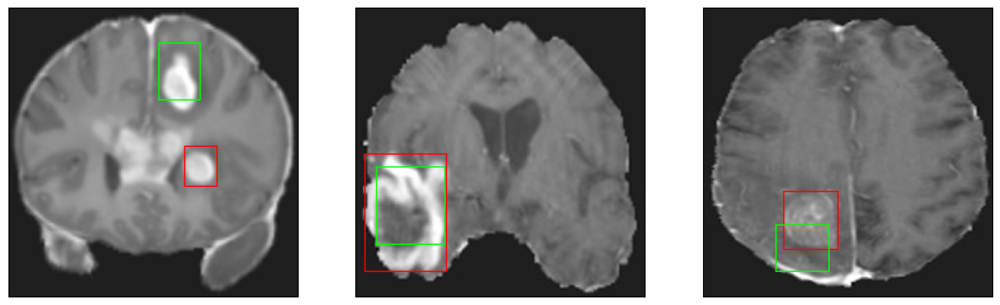

26/26 [==============================] - 8s 293ms/step - loss: 6.1286 - IoU: 0.5489 - val_loss: 8.6805 - val_IoU: 0.5255
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 5.6908 - IoU: 0.5724
Epoch 129: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 43ms/step
4


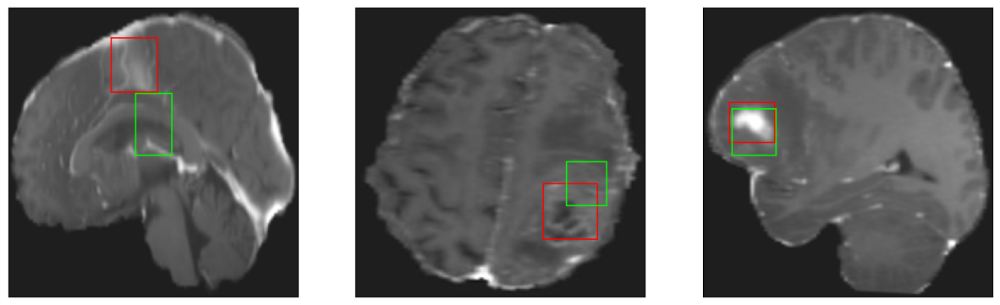

26/26 [==============================] - 8s 305ms/step - loss: 5.6908 - IoU: 0.5724 - val_loss: 8.9383 - val_IoU: 0.5131
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 5.5454 - IoU: 0.5825
Epoch 130: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 43ms/step
4
8/8 [==============================] - 0s 41ms/step
4


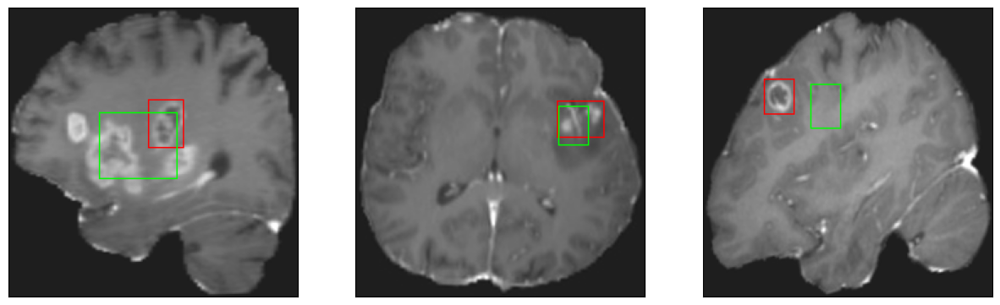

26/26 [==============================] - 8s 305ms/step - loss: 5.5454 - IoU: 0.5825 - val_loss: 10.1645 - val_IoU: 0.4727
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 5.7748 - IoU: 0.5729
Epoch 131: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 43ms/step
4


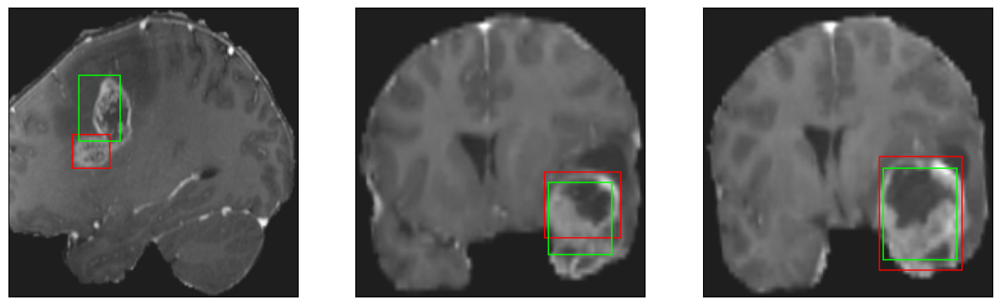

26/26 [==============================] - 8s 312ms/step - loss: 5.7748 - IoU: 0.5729 - val_loss: 9.1192 - val_IoU: 0.5126
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 5.7113 - IoU: 0.5603
Epoch 132: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


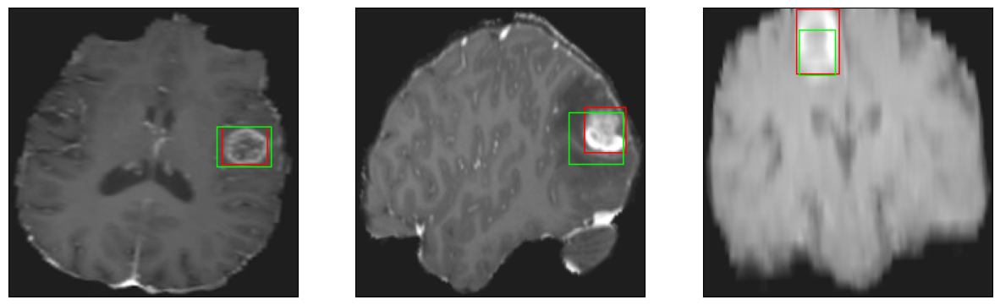

26/26 [==============================] - 8s 313ms/step - loss: 5.7113 - IoU: 0.5603 - val_loss: 8.5906 - val_IoU: 0.5297
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 5.8853 - IoU: 0.5713
Epoch 133: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 44ms/step
4


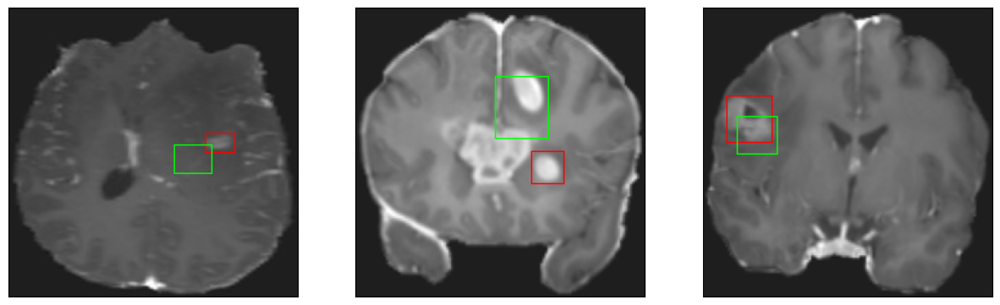

26/26 [==============================] - 8s 307ms/step - loss: 5.8853 - IoU: 0.5713 - val_loss: 8.9458 - val_IoU: 0.5208
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 5.6728 - IoU: 0.5783
Epoch 134: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


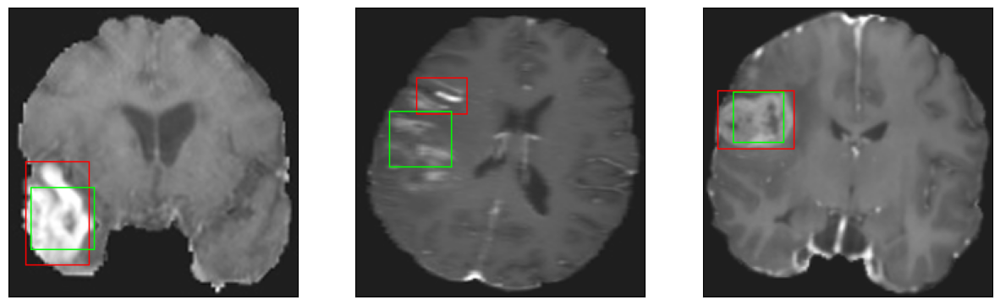

26/26 [==============================] - 8s 325ms/step - loss: 5.6728 - IoU: 0.5783 - val_loss: 9.2317 - val_IoU: 0.4988
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 5.6985 - IoU: 0.5814
Epoch 135: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 41ms/step
4


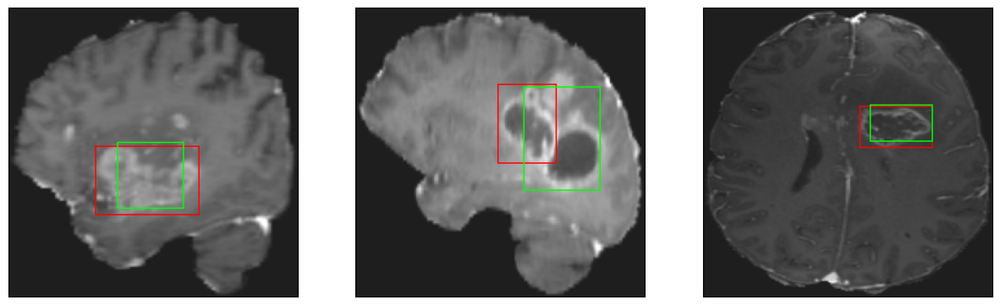

26/26 [==============================] - 8s 309ms/step - loss: 5.6985 - IoU: 0.5814 - val_loss: 8.8799 - val_IoU: 0.5315
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.8070 - IoU: 0.5780
Epoch 136: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


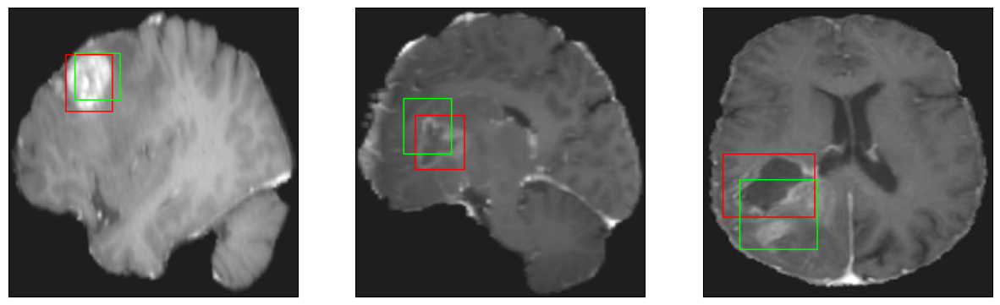

26/26 [==============================] - 8s 322ms/step - loss: 5.8070 - IoU: 0.5780 - val_loss: 9.0225 - val_IoU: 0.5300
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 5.7986 - IoU: 0.5735
Epoch 137: val_IoU did not improve from 0.55032
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 44ms/step
4
8/8 [==============================] - 0s 45ms/step
4


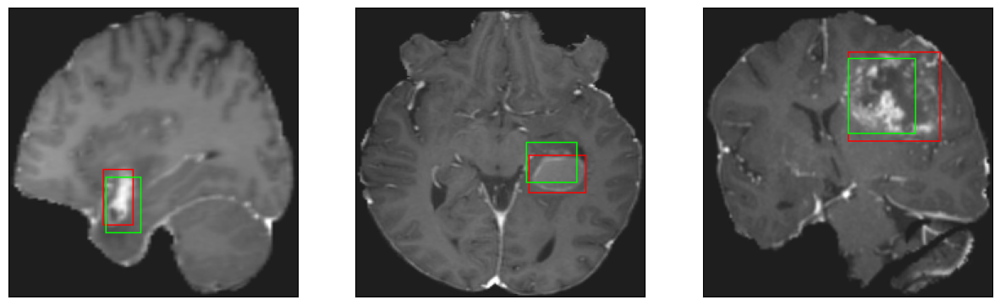

26/26 [==============================] - 7s 286ms/step - loss: 5.7986 - IoU: 0.5735 - val_loss: 9.0946 - val_IoU: 0.5207
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.6690 - IoU: 0.5815
Epoch 138: val_IoU did not improve from 0.55032
Restoring model weights from the end of the best epoch: 118.
8/8 [==============================] - 0s 41ms/step
4
8/8 [==============================] - 0s 42ms/step
4
8/8 [==============================] - 0s 40ms/step
4


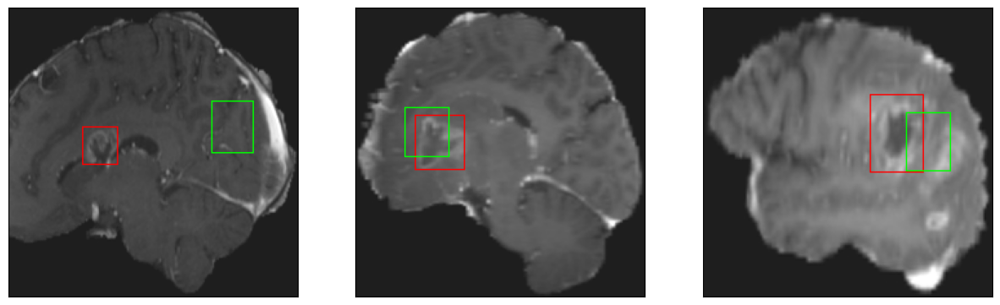

26/26 [==============================] - 8s 325ms/step - loss: 5.6690 - IoU: 0.5815 - val_loss: 9.4787 - val_IoU: 0.5176
Epoch 138: early stopping


In [25]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

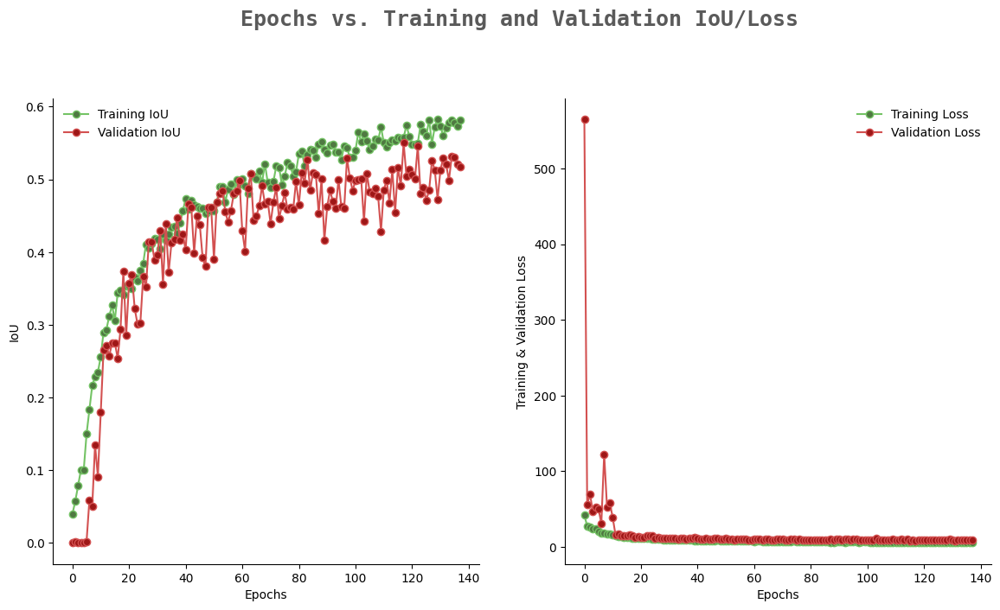

In [27]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(138)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [28]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [29]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [30]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 67ms/step - loss: 9.1496 - IoU: 0.5071


[9.149550437927246, 0.5071297883987427]